In [2]:
#!pip install spectrum_utils[iplot]

In [1]:
import spectrum_utils.spectrum as sus
import spectrum_utils.plot as sup
#import pyteomics.mgf as mgf
import pyteomics.mzxml as mzxml
import matplotlib.pyplot as plt
import numpy as np
import os
import matplotlib.backends.backend_pdf
import pandas as pd
import pickle
from pyteomics import mass, parser
import ast
from scipy import stats

In [2]:
#overwrite black picks to grey
sup.colors['?']="#c4c0c0"
sup.colors['f']="#c4c0c0"
sup.colors[None]="#c4c0c0"

In [3]:
sup.colors

{'a': '#388E3C',
 'b': '#1976D2',
 'c': '#00796B',
 'x': '#7B1FA2',
 'y': '#D32F2F',
 'z': '#F57C00',
 'm': '#FBC02D',
 'I': '#455A64',
 'p': '#512DA8',
 '?': '#c4c0c0',
 'f': '#c4c0c0',
 None: '#c4c0c0'}

In [2]:
# mzspec:PXD014258:ESC-HF-Sample-BT474_3.RAW.raw:scan:10356:KLLESEESHLESGMQNMSIHTK/4
# mzspec:PXD003594:b1369p080_sample_10_b.raw:scan:17234:YADL[UNIMOD:35]T[UNIMOD:35]E[UNIMOD:35]D[UNIMOD:35]L[UNIMOD:35]LPSC[UNIMOD:4]ESLKDTIAR/3
# mzspec:PXD003594:b1369p080_sample_01_a.raw:scan:15739:NQGT[UNIMOD:121]VNWSVDDIVK/2

In [4]:
# Define the MzXML file path

mzxml_folder="/project/def-marie87/vvshazia/pride_reanalysis/msfragger_pride_reanalysis/mzXML/"
figsave_folder="./oui_discovery_gwalk_subfigures/explore-3-hybrid-noncanon-spectra/"

In [7]:
insituPEP=pd.read_csv("./../insitu_peptides.csv")

### Visualise spectra and MS2PIP predictions for high-scoring PSMs of HPP-pass non-canonical peptides

In [41]:
#get the PCC of real and theoretical spectra
def PCC(spec,ms2pip_spec):    
    ms2pip_ann=pd.DataFrame({str(peak).split("/")[0]:[intensity] for peak,intensity in zip(ms2pip_spec.annotation,ms2pip_spec.intensity)}).T
    #print(ms2pip_ann)
    spec_ann=pd.DataFrame({str(peak).split("/")[0].split("^")[0]:[intensity] for peak,intensity in zip(spec.annotation,spec.intensity) if "b" in str(peak) or "y" in str(peak)}).T
    #print(spec_ann)
    spec_merge=ms2pip_ann.merge(spec_ann,left_index=True,right_index=True,how="outer",suffixes=("ms2pip","spec"))
    spec_merge.fillna(0,inplace=True)
    #print(spec_merge)
    res=np.corrcoef(spec_merge["0spec"],spec_merge["0ms2pip"])
    return res[0,1],spec_merge

In [9]:
#get the SCC (spearman) of real and theoretical spectra
def SCC(spec,ms2pip_spec):    
    ms2pip_ann=pd.DataFrame({str(peak).split("/")[0]:[intensity] for peak,intensity in zip(ms2pip_spec.annotation,ms2pip_spec.intensity)}).T
    #print(ms2pip_ann)
    spec_ann=pd.DataFrame({str(peak).split("/")[0].split("^")[0]:[intensity] for peak,intensity in zip(spec.annotation,spec.intensity) if "b" in str(peak) or "y" in str(peak)}).T
    #print(spec_ann)
    spec_merge=ms2pip_ann.merge(spec_ann,left_index=True,right_index=True,how="outer",suffixes=("ms2pip","spec"))
    spec_merge.fillna(0,inplace=True)
    spec_merge=spec_merge/spec_merge.max()
    #print(spec_merge)
    #res=np.corrcoef(spec_merge["0spec"],spec_merge["0ms2pip"])
    scc,p=stats.spearmanr(spec_merge["0spec"],spec_merge["0ms2pip"])
    return scc,spec_merge

In [10]:
#get broken bounds
def get_BB(spec_merge,peptide):
    bs=[int(ion.replace("b","")) for ion in spec_merge[spec_merge["0spec"]!=0].index if "b" in ion]
    ys=[len(pep)-int(ion.replace("y","")) for ion in spec_merge[spec_merge["0spec"]!=0].index if "y" in ion]
    return len(set(bs+ys))

In [11]:
nc_toexplore=pd.read_csv("ionbot_open_noncanon_psm_hpp_pass_2.csv")
#explore only best scoring
nc_toexplore=nc_toexplore[nc_toexplore.isBest]

In [28]:
nc_toexplore_prev=pd.read_csv("./../ionbot_open_noncanon_psm_hpp_pass_2.csv")
#explore only best scoring
nc_toexplore_prev=nc_toexplore_prev[nc_toexplore_prev.isBest]

In [35]:
new= set(nc_toexplore.spectrum_title.unique()) - set(nc_toexplore_prev.spectrum_title.unique())
#nc_toexplore[nc_toexplore.spectrum_title.isin(new)].iloc[0]
len(new)

20

In [42]:
new

{'130327_o2_01_hu_C1_2hr: controllerType=0 controllerNumber=1 scan=13864',
 '130327_o2_02_hu_P1_2hr: controllerType=0 controllerNumber=1 scan=12348',
 '130327_o2_03_hu_C2_2hr: controllerType=0 controllerNumber=1 scan=19753',
 '130327_o2_05_hu_C3_2hr: controllerType=0 controllerNumber=1 scan=29988',
 '130327_o2_06_hu_P3_2hr: controllerType=0 controllerNumber=1 scan=23279',
 'AM11:controllerType=0 controllerNumber=1 scan=25754',
 'AM16:controllerType=0 controllerNumber=1 scan=15674',
 'AM18:controllerType=0 controllerNumber=1 scan=16852',
 'AM19:controllerType=0 controllerNumber=1 scan=24905',
 'ESC-HF-Sample-BT474_2:controllerType=0 controllerNumber=1 scan=10786',
 'ESC-HF-Sample-BT474_2:controllerType=0 controllerNumber=1 scan=11689',
 'ESC-HF-Sample-BT474_3:controllerType=0 controllerNumber=1 scan=10531',
 'ESC-HF-Sample-BT474_3:controllerType=0 controllerNumber=1 scan=12311',
 'ESC-HF-Sample-BT474_3:controllerType=0 controllerNumber=1 scan=6046',
 'ESC-HF-Sample-BT474_3:controllerTyp

In [12]:
#collect the spectra and info 

nc_spectra_dict={}
for i,row in nc_toexplore.iterrows():
    #if i<181: continue
    target_title=f"{row['scan']}"
    target_file=row["spectrum_file_mzxml"].split(".")[0]
    set_charge=row["charge"]
    dataset=row["dataset"].replace(".v0.11.4","")
    mzxml_file =row["spectrum_file_mzxml"] 
    spectra = mzxml.read(os.path.join(mzxml_folder,dataset+"_mzXML",mzxml_file)) #read each time againe
    print(target_title, target_file,set_charge,dataset, i)
    # Parse the mzXML file and find the matching spectrum
    for spectrum in spectra:
        if target_title==spectrum['num']: 
            print("found")
            mz_values = np.array(spectrum['m/z array'])
            intensities = np.array(spectrum['intensity array'])
            precursor_mz = float(spectrum['precursorMz'][0]['precursorMz'])

            # Ensure charge is an integer
            precursor_charge = int(spectrum['precursorMz'][0]['precursorCharge'])

            retention_time = float(spectrum['retentionTime'])
            
            nc_spectra_dict[f"{target_file}|{target_title}"]={
                "mzxml":mzxml_file,
                "identifier":target_title,
                "precursor_mz":precursor_mz,
                "precursor_charge":precursor_charge,  # Ensure it's an int
                "charge from ionbot":set_charge,
                "mz":mz_values,
                "intensity":intensities,
                "retention_time":retention_time
            }

29841 130327_o2_01_hu_C1_2hr 3 PXD002057 1
found
34011 130327_o2_01_hu_C1_2hr 3 PXD002057 4
found
23567 130327_o2_01_hu_C1_2hr 3 PXD002057 5
found
13864 130327_o2_01_hu_C1_2hr 2 PXD002057 7
found
30194 130327_o2_01_hu_C1_2hr 3 PXD002057 15
found
13750 130327_o2_01_hu_C1_2hr 3 PXD002057 21
found
25743 130327_o2_01_hu_C1_2hr 4 PXD002057 22
found
20190 130327_o2_01_hu_C1_2hr 3 PXD002057 24
found
28953 130327_o2_01_hu_C1_2hr 3 PXD002057 29
found
22921 130327_o2_01_hu_C1_2hr 2 PXD002057 31
found
14456 130327_o2_01_hu_C1_2hr 2 PXD002057 32
found
7598 130327_o2_01_hu_C1_2hr 2 PXD002057 33
found
32510 130327_o2_02_hu_P1_2hr 3 PXD002057 34
found
10082 130327_o2_02_hu_P1_2hr 3 PXD002057 42
found
12627 130327_o2_02_hu_P1_2hr 2 PXD002057 43
found
30881 130327_o2_02_hu_P1_2hr 3 PXD002057 48
found
8205 130327_o2_02_hu_P1_2hr 2 PXD002057 50
found
10343 130327_o2_02_hu_P1_2hr 2 PXD002057 56
found
12348 130327_o2_02_hu_P1_2hr 2 PXD002057 60
found
34841 130327_o2_02_hu_P1_2hr 2 PXD002057 64
found
10700 

In [13]:
#check that all were found
len(nc_spectra_dict)==len(nc_toexplore)

True

In [14]:
with open('ionbot_open_noncanon_hpp_pass_nc_spectra_dict.pickle', 'wb') as handle:
    pickle.dump(nc_spectra_dict, handle, protocol=pickle.HIGHEST_PROTOCOL)

In [36]:
#prepare files for ms2pip

#custom modification list
#Name,mass,aa
ms2pip_mods=pd.DataFrame([[str(mod[2]),mod[2],mod[1]] 
                         for mods in nc_toexplore[nc_toexplore.modifications_masses!='Unmodified'].modifications_masses.tolist() 
                         for mod in ast.literal_eval(mods)],
                         columns=["name","mass","aa"])
ms2pip_mods.drop_duplicates(inplace=True)
ms2pip_mods.to_csv("noncanon_hpp_pass_ms2pip_mods.csv",index=False)

#PEPREC file
ms2pip_peprec=pd.DataFrame([ [row["scan"],
                              "|".join([f"{mod[0]}|{mod[2]}" for mod in ast.literal_eval(row["modifications_masses"])])
                              if row["modifications_masses"]!='Unmodified' else "-",
                             row["database_peptide"], row["charge"] ] 
                            for i, row in nc_toexplore.iterrows()],
                          columns=["spec_id", "modifications", "peptide", "charge"])
ms2pip_peprec.to_csv("noncanon_hpp_pass_ms2pip_peprec.csv",index=False)

In [37]:
#load ms2pip results and parse

ms2pip_predictions=pd.read_csv("noncanon_hpp_pass_ms2pip_predictions.csv")
ms2pip_predictions["ion"].replace("B","b",inplace=True)
ms2pip_predictions["ion"].replace("Y","y",inplace=True)

/tmp/ipykernel_1072960/826095027.py:4: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  ms2pip_predictions["ion"].replace("B","b",inplace=True)
/tmp/ipykernel_1072960/826095027.py:5: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=T

In [38]:
#plot and get PCC

130327_o2_01_hu_C1_2hr|29841
130327_o2_01_hu_C1_2hr|34011
130327_o2_01_hu_C1_2hr|23567
130327_o2_01_hu_C1_2hr|13864
130327_o2_01_hu_C1_2hr|30194
130327_o2_01_hu_C1_2hr|13750
130327_o2_01_hu_C1_2hr|25743
130327_o2_01_hu_C1_2hr|20190
130327_o2_01_hu_C1_2hr|28953
130327_o2_01_hu_C1_2hr|22921
130327_o2_01_hu_C1_2hr|14456
130327_o2_01_hu_C1_2hr|7598
130327_o2_02_hu_P1_2hr|32510
130327_o2_02_hu_P1_2hr|10082
130327_o2_02_hu_P1_2hr|12627
130327_o2_02_hu_P1_2hr|30881
130327_o2_02_hu_P1_2hr|8205
130327_o2_02_hu_P1_2hr|10343
130327_o2_02_hu_P1_2hr|12348
130327_o2_02_hu_P1_2hr|34841
130327_o2_04_hu_P2_2hr|10700


/tmp/ipykernel_1072960/808538919.py:57: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(12, 8))


130327_o2_04_hu_P2_2hr|13343
130327_o2_04_hu_P2_2hr|25438
130327_o2_04_hu_P2_2hr|20228
130327_o2_04_hu_P2_2hr|20778
130327_o2_04_hu_P2_2hr|18666
130327_o2_04_hu_P2_2hr|8188
130327_o2_04_hu_P2_2hr|21122
130327_o2_04_hu_P2_2hr|22456
130327_o2_04_hu_P2_2hr|20421
130327_o2_06_hu_P3_2hr|20921
130327_o2_06_hu_P3_2hr|26059
130327_o2_06_hu_P3_2hr|22143
130327_o2_06_hu_P3_2hr|25464
130327_o2_06_hu_P3_2hr|26431
130327_o2_06_hu_P3_2hr|21058
130327_o2_06_hu_P3_2hr|23279
130327_o2_06_hu_P3_2hr|28010
130327_o2_05_hu_C3_2hr|19213
130327_o2_05_hu_C3_2hr|13799
130327_o2_05_hu_C3_2hr|16854
130327_o2_05_hu_C3_2hr|17265
130327_o2_05_hu_C3_2hr|19755
130327_o2_05_hu_C3_2hr|29988
130327_o2_03_hu_C2_2hr|25270
130327_o2_03_hu_C2_2hr|19753
AM12|30592
AM12|29245
AM12|22646
AM16|33606
AM16|15674
AM16|14314
AM16|24032
AM16|27699
AM16|30855
AM16|24733
AM16|30165
AM16|31589
AM16|25091
AM16|32233
AM16|19521
AM20|28589
AM20|22736
AM20|18305
AM20|31379
AM20|28062
AM20|28420
AM7|10980
AM18|9343
AM18|24017
AM18|16852
AM1

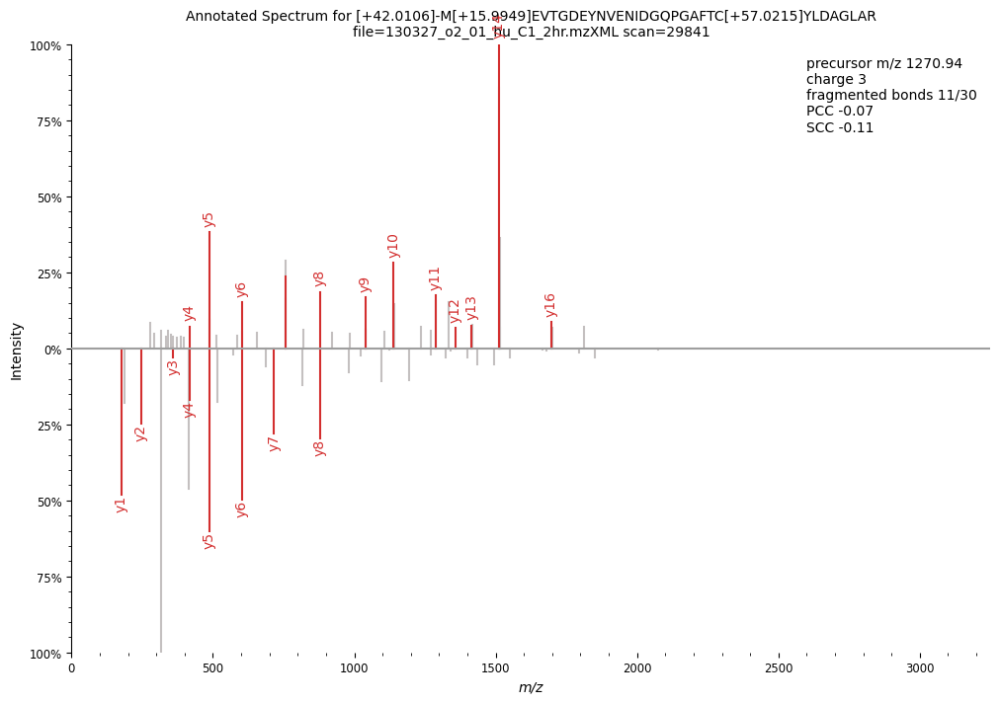

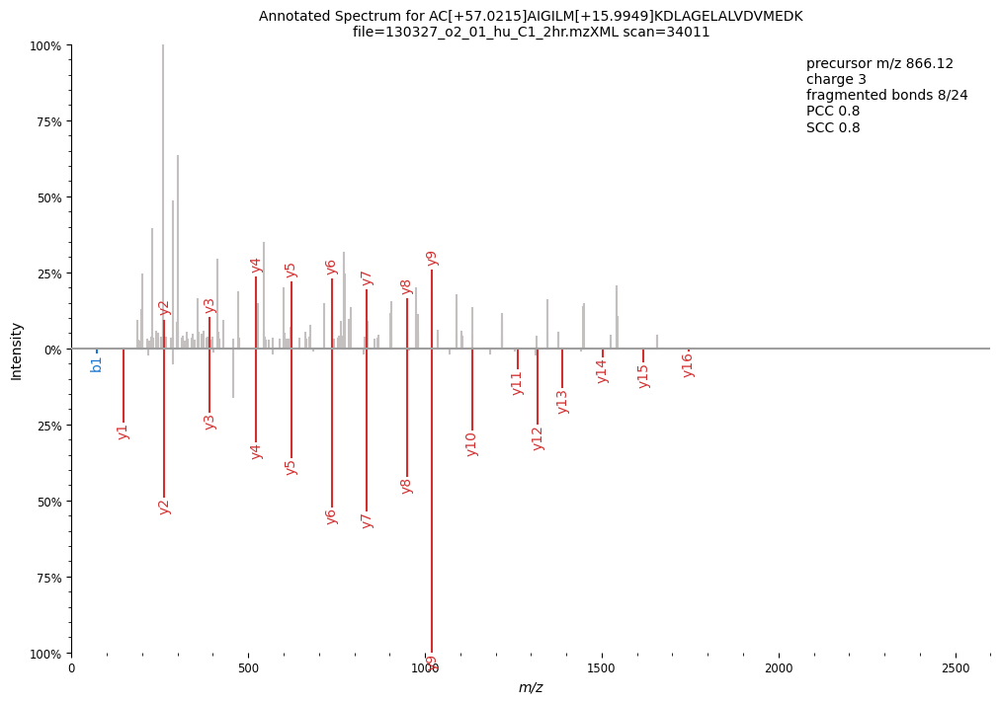

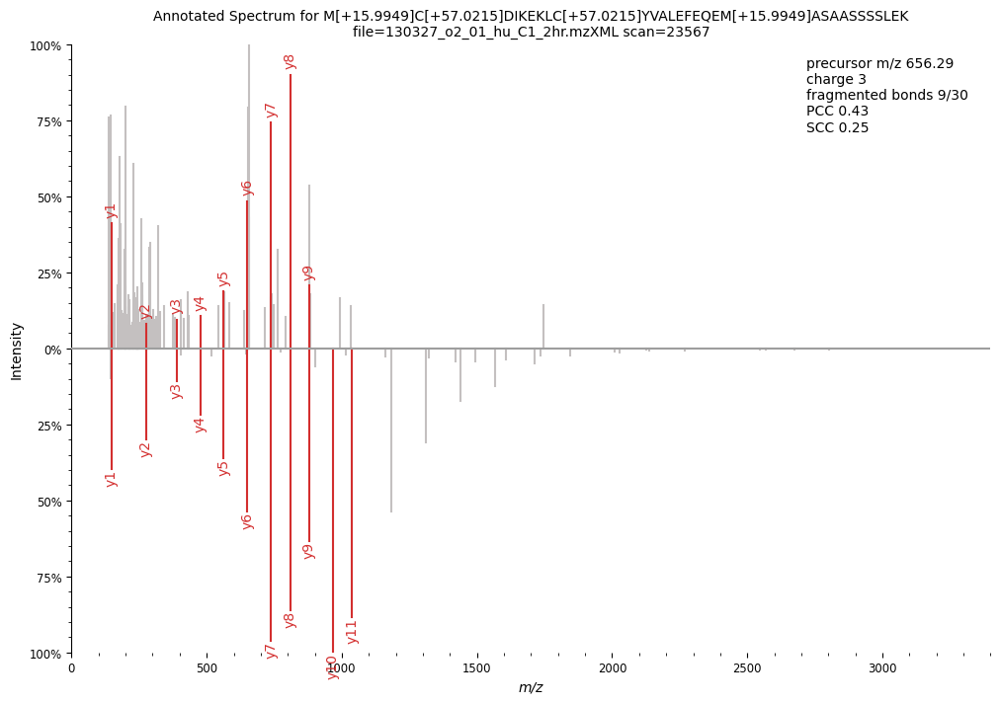

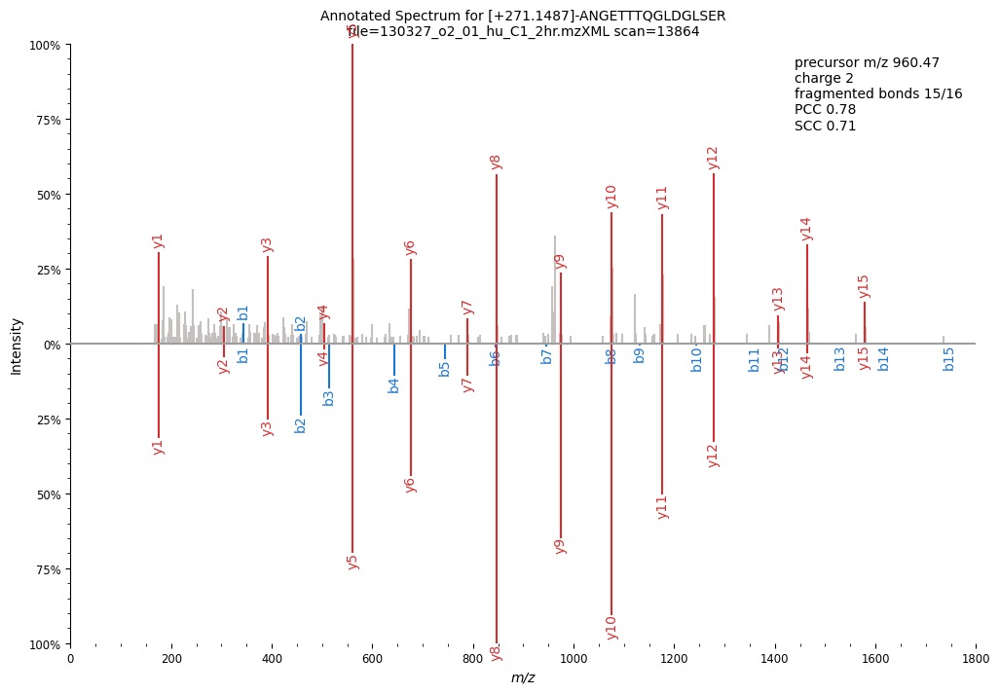

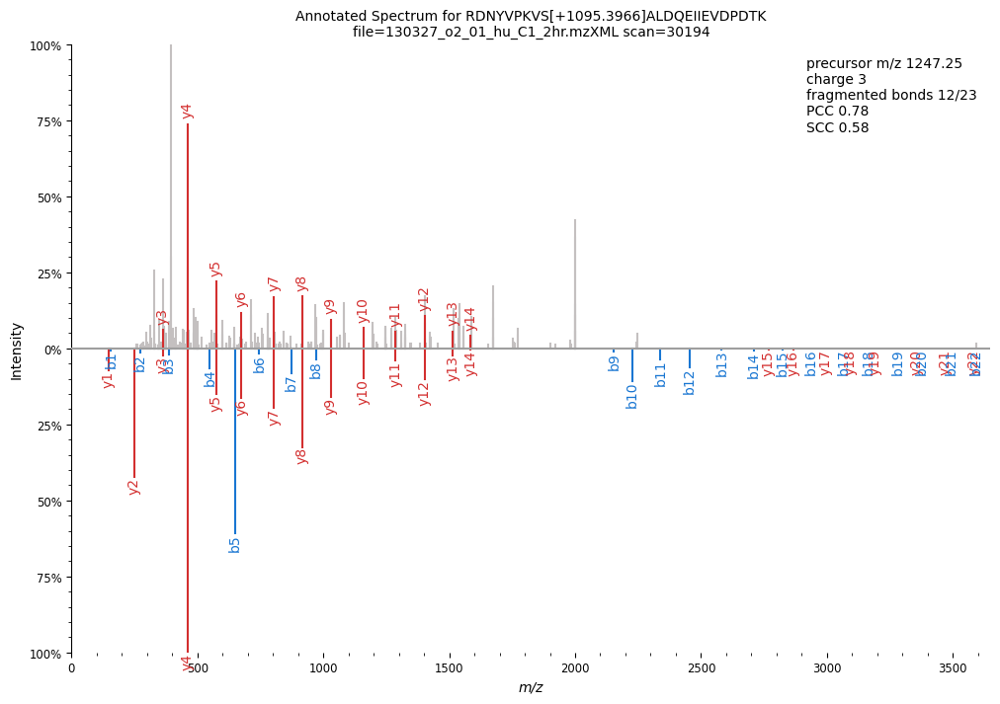

...

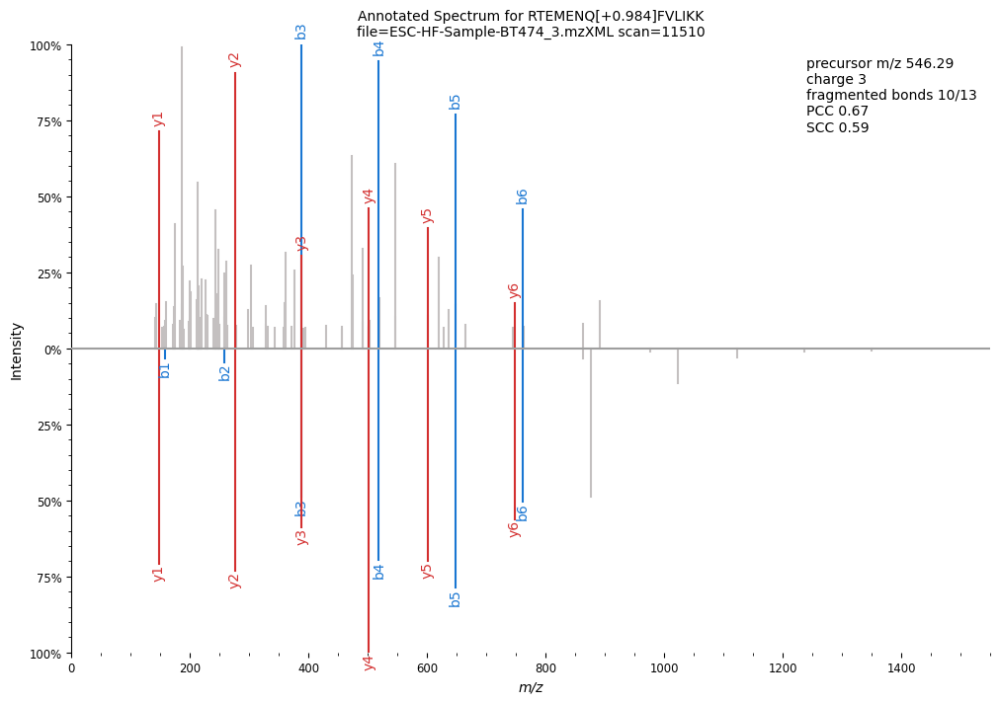

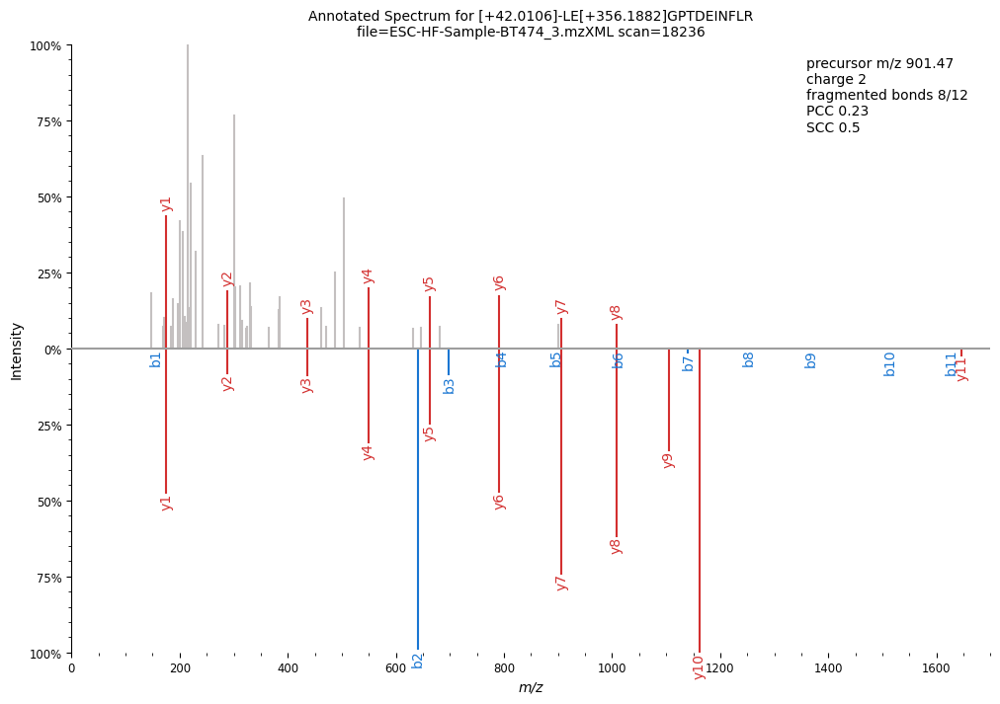

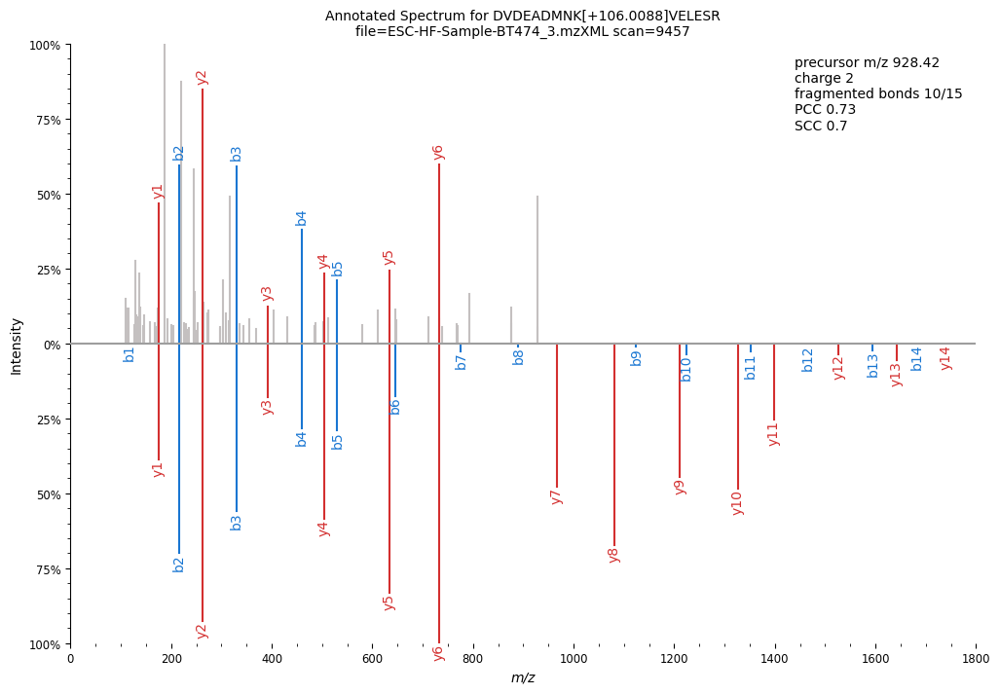

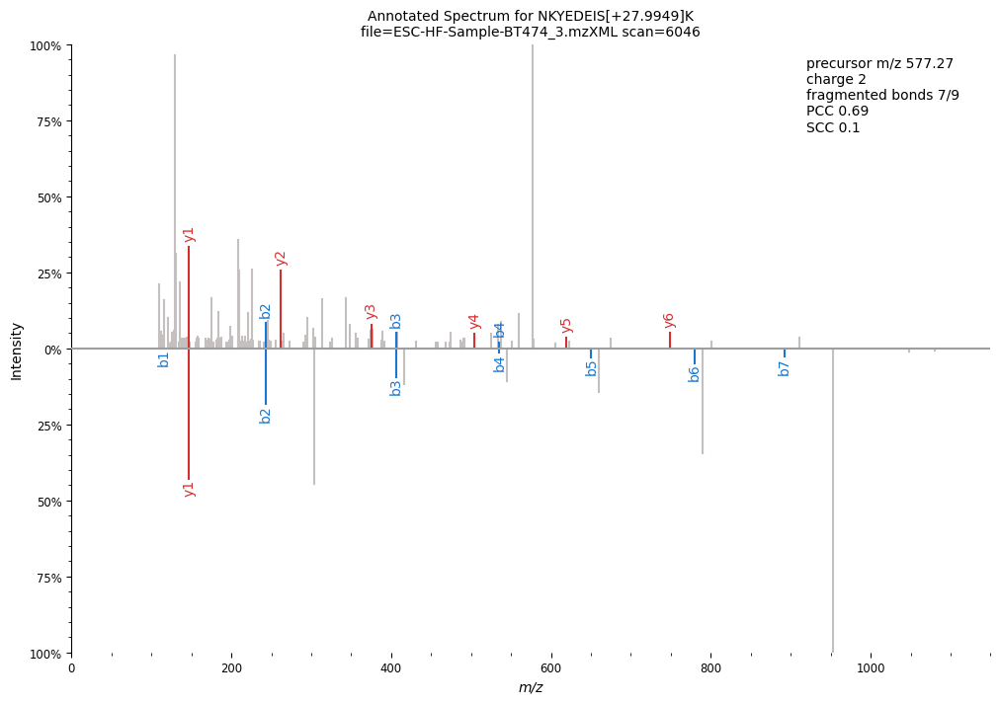

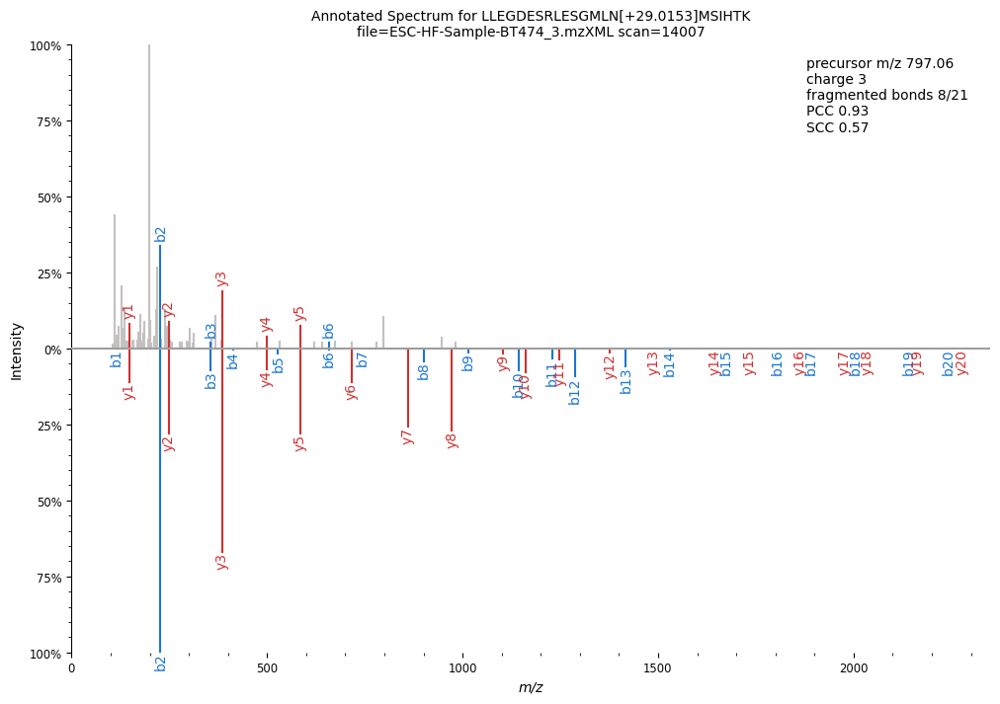

In [43]:
pdf = matplotlib.backends.backend_pdf.PdfPages(f"{figsave_folder}nc_HPPpass_best_psms_v5.pdf")
PCC_dict={}
SCC_dict={}
BB_dict={}
for key in nc_spectra_dict.keys():
    print(key)
    scan=int(nc_spectra_dict[key]["identifier"])
    ms2pip_spec=ms2pip_predictions[ms2pip_predictions.spec_id==scan]
    plot_mz_min,plot_mz_max=ms2pip_spec.mz.min()-10, ms2pip_spec.mz.max()+10
    # Create the spectrum
    spec = sus.MsmsSpectrum(
        identifier=nc_spectra_dict[key]["identifier"],
        precursor_mz=nc_spectra_dict[key]["precursor_mz"],
        precursor_charge=nc_spectra_dict[key]["precursor_charge"], 
        mz=nc_spectra_dict[key]["mz"],
        intensity=nc_spectra_dict[key]["intensity"],
        retention_time=nc_spectra_dict[key]["retention_time"]
    )

    # Set mz range and filter
    spec = spec.set_mz_range(min_mz=plot_mz_min, max_mz=plot_mz_max)  
    spec = spec.scale_intensity() 
    #spec = spec.filter_intensity(0.01) 


    # Annotate with peptide sequence
    peptide_sequence=nc_toexplore.loc[nc_toexplore.scan==scan,"peptide_spectrum_utils"].iloc[0]
    spec.annotate_proforma(peptide_sequence, 20, "ppm")

    # Create mirrored spectrum
    mirrored_spec = sus.MsmsSpectrum(
        identifier=spec.identifier,
        precursor_mz=spec.precursor_mz,
        precursor_charge=spec.precursor_charge,
        mz=ms2pip_spec.mz.to_numpy(),
        intensity=ms2pip_spec.prediction.to_numpy(),
        retention_time=spec.retention_time
    )

    mirrored_spec = mirrored_spec.set_mz_range(min_mz=plot_mz_min, max_mz=plot_mz_max)  
    mirrored_spec = mirrored_spec.scale_intensity() 
    #mirrored_spec = mirrored_spec.filter_intensity(0.01) 
    
    #peptide_sequence_ms2pip=nc_toexplore.loc[nc_toexplore.scan==scan,"database_peptide_x"].iloc[0]
    mirrored_spec.annotate_proforma(peptide_sequence, 20, "ppm")
    
    pcc,spec_merge=PCC(spec,mirrored_spec)
    PCC_dict[key]=pcc
    scc,_=SCC(spec,mirrored_spec)
    SCC_dict[key]=scc
    #frb=len(set([int(ion.replace("b","").replace("y","")) for ion in spec_merge[spec_merge["0spec"]!=0].index]))
    pep=nc_toexplore.loc[nc_toexplore.scan==scan,"database_peptide"].iloc[0]
    frb=get_BB(spec_merge,pep)
    BB_dict[key]=frb/len(pep)
    
    # Plot original and mirrored spectra
    fig, ax = plt.subplots(figsize=(12, 8))

    # Plot mirrored (bottom)

    sup.mirror(spec, mirrored_spec, ax=ax,spectrum_kws={"grid":False})    
    #sup.facet(spec, spec, mirrored_spec, ax=ax,spectrum_kws={"grid":False})    
    
    info=f'precursor m/z {round(nc_spectra_dict[key]["precursor_mz"],2)}\ncharge {nc_spectra_dict[key]["precursor_charge"]}\nfragmented bonds {frb}/{len(pep)}\nPCC {round(pcc,2)}\nSCC {round(scc,2)}\n'
    ax.text(
        0.80, 0.98,
        info, 
        ha='left', va='top',
        transform=ax.transAxes,
        fontsize=10, color='black',
        bbox=dict(facecolor='white', alpha=0.5, edgecolor='none'))
    
    # Titles and labels
    #peptide_sequence_plot=nc_toexplore.loc[nc_toexplore.scan==scan,"custom_peptide"].iloc[0]
    ax.set_title(f"Annotated Spectrum for {peptide_sequence}\nfile={nc_spectra_dict[key]['mzxml']} scan={scan}",fontsize=10)
    ax.set_xlabel("m/z")
    ax.set_ylabel("Intensity")
    ax.spines['bottom'].set_visible(False)       
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    #break
    #plt.show()
    pdf.savefig(fig)
#pdf.close()

In [44]:
pdf.close()

In [45]:
#{v:nc_toexplore[(nc_toexplore.spectrum_file.str.contains(k.split("|")[0]))&(nc_toexplore.scan==int(k.split("|")[1]))].modifications_masses.tolist() 
# for k,v in PCC_dict.items() if v<=0}

Text(0.5, 1.0, 'PCC')

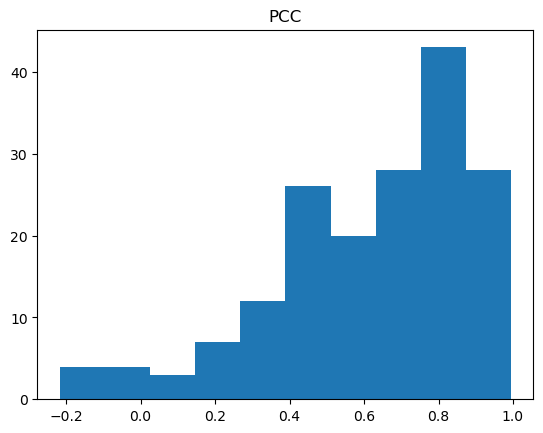

In [46]:
plt.hist(PCC_dict.values());
plt.title("PCC")

Text(0.5, 1.0, 'fragmented bounds %')

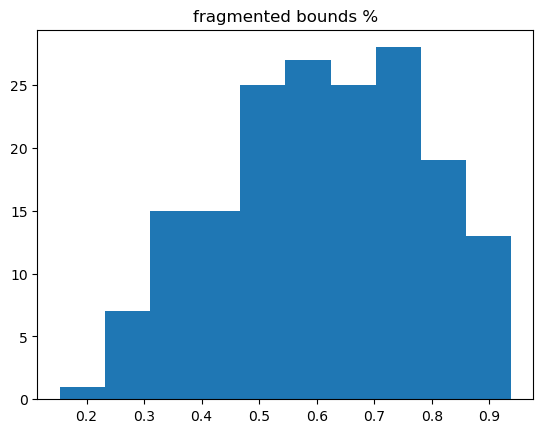

In [47]:
plt.hist(BB_dict.values());
plt.title("fragmented bounds %")

### Visualise pairs with alternative peptide sequence (isoSAAV that have SAAV in gnomAD)

In [48]:
comb_datasets_ncpsm_altpepcomb=pd.read_pickle("comb_datasets_ncpsm_altpepcomb.pkl")

In [49]:
comb_datasets_ncpsm_altpepcomb["peptides_w1sub_USI"]="mzspec:"+comb_datasets_ncpsm_altpepcomb.dataset.apply(lambda x: x.split(".")[0])+":"+comb_datasets_ncpsm_altpepcomb.peptides_w1sub_spectrum_utils+"/"+comb_datasets_ncpsm_altpepcomb.charge.astype(str)

In [50]:
#select spectra from mzXML ....

nc_spectra_foraltpep_dict={}
for i,row in comb_datasets_ncpsm_altpepcomb.drop_duplicates("spectrum_title").iterrows():
    #if i<181: continue
    target_title=f"{row['scan']}"
    target_file=row["spectrum_file_mzxml"].split(".")[0]
    set_charge=row["charge"]
    dataset=row["dataset"].replace(".v0.11.4","")
    mzxml_file =row["spectrum_file_mzxml"] 
    spectra = mzxml.read(os.path.join(mzxml_folder,dataset+"_mzXML",mzxml_file)) #read each time againe
    print(target_title, target_file,set_charge,dataset, i)
    # Parse the mzXML file and find the matching spectrum
    for spectrum in spectra:
        if target_title==spectrum['num']: 
            print("found")
            mz_values = np.array(spectrum['m/z array'])
            intensities = np.array(spectrum['intensity array'])
            precursor_mz = float(spectrum['precursorMz'][0]['precursorMz'])

            # Ensure charge is an integer
            precursor_charge = int(spectrum['precursorMz'][0]['precursorCharge'])

            retention_time = float(spectrum['retentionTime'])
            
            nc_spectra_foraltpep_dict[f"{target_file}|{target_title}"]={
                "mzxml":mzxml_file,
                "identifier":target_title,
                "precursor_mz":precursor_mz,
                "precursor_charge":precursor_charge,  # Ensure it's an int
                "charge from ionbot":set_charge,
                "mz":mz_values,
                "intensity":intensities,
                "retention_time":retention_time
            }



30203 AM19 3 PXD005833 0
found
29427 AM17 3 PXD005833 1
found
29436 AM17 3 PXD005833 2
found
29504 AM21 3 PXD005833 3
found
29681 AM15 3 PXD005833 4
found
22040 ESC-HF-Sample-MCF5 3 PXD014258 10
found
13639 ESC-HF-Sample-BT474_1 3 PXD014258 11
found
23350 AM16 3 PXD005833 12
found
27397 AM8 2 PXD005833 13
found
22736 AM20 3 PXD005833 14
found
23679 AM13 3 PXD005833 15
found
23457 AM14 3 PXD005833 16
found
19419 ESC-HF-Sample-MCF1 2 PXD014258 17
found
19212 ESC-HF-Sample-BT474_2 3 PXD014258 18
found
20334 ESC-HF-Sample-BT474_2 2 PXD014258 19
found


In [51]:
with open('nc_spectra_foraltpep_dict.pickle', 'wb') as handle:
    pickle.dump(nc_spectra_foraltpep_dict, handle, protocol=pickle.HIGHEST_PROTOCOL)

In [52]:
comb_datasets_ncpsm_altpepcomb.columns

Index(['database_peptide', 'peptide_class', 'leadprot', 'peptide_length',
       'peptide_position', 'isSubstitution', 'dataset', 'spectrum_title',
       'scan', 'spectrum_file', 'observed_retention_time', 'charge',
       'modifications_masses', 'fraction_psm_wsub', 'modifications_set',
       'residues_to_sub', 'pos_to_sub', 'sub_rule', 'peptides_w1sub',
       'saav_info_pep', 'saav_info_prot', 'saav_info_triplet', 'strand',
       'chromosome', 'gene', 'saav_info_refcod', 'saav_info_refcod_rev',
       'is_expected_aa', 'segments', 'cds_segments', 'chromosome_cds',
       'REF_ALT', 'triplet', 'triplet_cds_pos', 'ALT', 'REF',
       'chromosome_cds_mutated', 'isSpliceVar', 'chromosome_cds_mutated_rev',
       'protein_mutated', 'isDisrupt', 'isSAAV', 'residues_to_sub_count',
       'isSAAV_tmp', 'af', 'tosub_aa', 'hasIsoSAAAV', 'modifications',
       'PTM_combs', 'peptide_spectrum_utils', 'peptides_w1sub_spectrum_utils',
       'spectrum_file_mzxml', 'peptides_w1sub_USI'],
      

In [67]:
#prepare files for ms2pip, do for moth alternative and original sequences

#custom modification list
#Name,mass,aa
ms2pip_mods_foraltpep=pd.DataFrame([[str(mod[2]),mod[2],mod[1]] 
                         for mods in comb_datasets_ncpsm_altpepcomb.PTM_combs.tolist() 
                         for mod in mods],
                         columns=["name","mass","aa"])
tmp=pd.DataFrame([[str(mod[2]),mod[2],mod[1]] 
                         for mods in comb_datasets_ncpsm_altpepcomb.drop_duplicates("spectrum_title").modifications_masses.tolist() 
                         for mod in mods],
                         columns=["name","mass","aa"])
ms2pip_mods_foraltpep=pd.concat([ms2pip_mods_foraltpep,tmp])
ms2pip_mods_foraltpep.drop_duplicates(inplace=True)
ms2pip_mods_foraltpep.to_csv("noncanon_hpp_pass_foraltpep_ms2pip_mods.csv",index=False)

#PEPREC file
ms2pip_peprec_foraltpep=pd.DataFrame([ [str(row["scan"])+f"_{i}_"+"_".join([str(mod[0]) for mod in row["PTM_combs"]]),
                              "|".join([f"{mod[0]}|{mod[2]}" for mod in row["PTM_combs"]]),
                             row["peptides_w1sub"], row["charge"] ] #would charge change??
                            for i, row in comb_datasets_ncpsm_altpepcomb.iterrows()],
                          columns=["spec_id", "modifications", "peptide", "charge"])
tmp=pd.DataFrame([ [str(row["scan"])+"_orig",
                              "|".join([f"{mod[0]}|{mod[2]}" for mod in row["modifications_masses"]]),
                             row["database_peptide"], row["charge"] ] #would charge change??
                            for i, row in comb_datasets_ncpsm_altpepcomb.drop_duplicates("spectrum_title").iterrows()],
                          columns=["spec_id", "modifications", "peptide", "charge"])
ms2pip_peprec_foraltpep=pd.concat([ms2pip_peprec_foraltpep,tmp])
ms2pip_peprec_foraltpep.to_csv("noncanon_hpp_pass_foraltpep_ms2pip_peprec.csv",index=False)

In [71]:
#load ms2pip results and parse

ms2pip_predictions_foraltpep=pd.read_csv("noncanon_hpp_pass_foraltpep_ms2pip_predictions.csv")
ms2pip_predictions_foraltpep["ion"].replace("B","b",inplace=True)
ms2pip_predictions_foraltpep["ion"].replace("Y","y",inplace=True)

/tmp/ipykernel_1072960/917835961.py:4: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  ms2pip_predictions_foraltpep["ion"].replace("B","b",inplace=True)
/tmp/ipykernel_1072960/917835961.py:5: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value,

In [72]:
#get PCC for alternative sequence, select the best per sequence

In [73]:
PCC_foraltpep_dict={}
BB_foraltpep_dict={}
comb_datasets_ncpsm_altpepcomb[["PCC","BB"]]=0
for i,row in comb_datasets_ncpsm_altpepcomb.iterrows():
    target_title=f"{row['scan']}"
    target_file=row["spectrum_file_mzxml"].split(".")[0]
    key=f"{target_file}|{target_title}"
    print(key)
    scan=int(nc_spectra_foraltpep_dict[key]["identifier"])
    ms2pip_scan=str(row["scan"])+f"_{i}_"+"_".join([str(mod[0]) for mod in row["PTM_combs"]])
    ms2pip_spec=ms2pip_predictions_foraltpep[ms2pip_predictions_foraltpep.spec_id==ms2pip_scan]
    plot_mz_min,plot_mz_max=ms2pip_spec.mz.min()-10, ms2pip_spec.mz.max()+10
    # Create the spectrum
    spec = sus.MsmsSpectrum(
        identifier=nc_spectra_foraltpep_dict[key]["identifier"],
        precursor_mz=nc_spectra_foraltpep_dict[key]["precursor_mz"],
        precursor_charge=nc_spectra_foraltpep_dict[key]["precursor_charge"], 
        mz=nc_spectra_foraltpep_dict[key]["mz"],
        intensity=nc_spectra_foraltpep_dict[key]["intensity"],
        retention_time=nc_spectra_foraltpep_dict[key]["retention_time"]
    )

    # Set mz range and filter
    spec = spec.set_mz_range(min_mz=plot_mz_min, max_mz=plot_mz_max)  
    spec = spec.scale_intensity() 
    #spec = spec.filter_intensity(0.01) 


    # Annotate with peptide sequence
    peptide_sequence=comb_datasets_ncpsm_altpepcomb.loc[i,"peptides_w1sub_spectrum_utils"].iloc[0]
            
    spec.annotate_proforma(peptide_sequence, 20, "ppm")
    
    if str(spec.annotation).count("?")==len(spec.annotation): #does not match any peak
        PCC_foraltpep_dict[ms2pip_scan]=0
        BB_foraltpep_dict[ms2pip_scan]=0
        continue
        
    # Create mirrored spectrum
    mirrored_spec = sus.MsmsSpectrum(
        identifier=spec.identifier,
        precursor_mz=spec.precursor_mz,
        precursor_charge=spec.precursor_charge,
        mz=ms2pip_spec.mz.to_numpy(),
        intensity=ms2pip_spec.prediction.to_numpy(),
        retention_time=spec.retention_time
    )

    mirrored_spec = mirrored_spec.set_mz_range(min_mz=plot_mz_min, max_mz=plot_mz_max)  
    mirrored_spec = mirrored_spec.scale_intensity() 
    #mirrored_spec = mirrored_spec.filter_intensity(0.01) 
    
    #peptide_sequence_ms2pip=nc_toexplore.loc[nc_toexplore.scan==scan,"database_peptide_x"].iloc[0]
    mirrored_spec.annotate_proforma(peptide_sequence, 20, "ppm")
    
    pcc,spec_merge=PCC(spec,mirrored_spec)
    PCC_foraltpep_dict[ms2pip_scan]=pcc
    frb=len(set([int(ion.replace("b","").replace("y","")) for ion in spec_merge[spec_merge["0spec"]!=0].index]))
    pep=comb_datasets_ncpsm_altpepcomb.loc[i,"peptides_w1sub"].iloc[0]
    BB_foraltpep_dict[ms2pip_scan]=frb/len(pep)
    comb_datasets_ncpsm_altpepcomb.loc[i,["PCC","BB"]]=[pcc,frb/len(pep)]

AM19|30203
AM19|30203


/tmp/ipykernel_1072960/2786187725.py:61: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.4302141370713512' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  comb_datasets_ncpsm_altpepcomb.loc[i,["PCC","BB"]]=[pcc,frb/len(pep)]
/tmp/ipykernel_1072960/2786187725.py:61: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.391304347826087' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  comb_datasets_ncpsm_altpepcomb.loc[i,["PCC","BB"]]=[pcc,frb/len(pep)]


AM17|29427
AM17|29427
AM17|29436
AM17|29436
AM21|29504
AM21|29504
AM15|29681
AM15|29681
AM19|30203
AM19|30203
AM17|29427
AM17|29427
AM17|29436
AM17|29436
AM21|29504
AM21|29504
AM15|29681
AM15|29681
ESC-HF-Sample-MCF5|22040
ESC-HF-Sample-MCF5|22040
ESC-HF-Sample-MCF5|22040
ESC-HF-Sample-BT474_1|13639
ESC-HF-Sample-BT474_1|13639
AM16|23350
AM16|23350
AM8|27397
AM8|27397
AM8|27397
AM20|22736
AM20|22736
AM20|22736
AM13|23679
AM13|23679
AM13|23679
AM14|23457
AM14|23457
AM14|23457
ESC-HF-Sample-MCF1|19419
ESC-HF-Sample-MCF1|19419
ESC-HF-Sample-MCF1|19419
ESC-HF-Sample-BT474_2|19212
ESC-HF-Sample-BT474_2|19212
ESC-HF-Sample-BT474_2|19212
ESC-HF-Sample-BT474_2|20334
ESC-HF-Sample-BT474_2|20334


In [74]:
#how many psms did not match with alternative sequence

len(comb_datasets_ncpsm_altpepcomb[comb_datasets_ncpsm_altpepcomb.PCC==0].scan.unique())

0

In [75]:
#how many alternative sequence did not match psm

len(comb_datasets_ncpsm_altpepcomb[comb_datasets_ncpsm_altpepcomb.PCC==0].peptides_w1sub.unique())

0

In [76]:
#select best match per psm; several possible variants can annotate same PSM - select best among them too

comb_datasets_ncpsm_altpepcomb["isBestPCC"]=False
for (spectrum_file,scan),group in comb_datasets_ncpsm_altpepcomb.groupby(["spectrum_file","scan"]): #peptides_w1sub
    group.sort_values("PCC",ascending=False,inplace=True)
    i=group.iloc[0].peptides_w1sub_spectrum_utils
    comb_datasets_ncpsm_altpepcomb.loc[(comb_datasets_ncpsm_altpepcomb.peptides_w1sub_spectrum_utils==i),"isBestPCC"]=True

In [77]:
#get PCC for database_peptide from spectra visualisation or calculate de novo

comb_datasets_ncpsm_altpepcomb[["database_peptide_PCC","database_peptide_BB"]]=0
for i,row in comb_datasets_ncpsm_altpepcomb.drop_duplicates("spectrum_title").iterrows():
    target_title=f"{row['scan']}"
    target_file=row["spectrum_file_mzxml"].split(".")[0]
    key=f"{target_file}|{target_title}"
    if key in PCC_dict:
        comb_datasets_ncpsm_altpepcomb.loc[i,["database_peptide_PCC","database_peptide_BB"]]=[PCC_dict[key],BB_dict[key]]
        continue
        
    scan=int(nc_spectra_foraltpep_dict[key]["identifier"])
    ms2pip_spec=ms2pip_predictions_foraltpep[ms2pip_predictions_foraltpep.spec_id==str(scan)+"_orig"]
    plot_mz_min,plot_mz_max=ms2pip_spec.mz.min()-10, ms2pip_spec.mz.max()+10
    # Create the spectrum
    spec = sus.MsmsSpectrum(
        identifier=nc_spectra_foraltpep_dict[key]["identifier"],
        precursor_mz=nc_spectra_foraltpep_dict[key]["precursor_mz"],
        precursor_charge=nc_spectra_foraltpep_dict[key]["precursor_charge"], 
        mz=nc_spectra_foraltpep_dict[key]["mz"],
        intensity=nc_spectra_foraltpep_dict[key]["intensity"],
        retention_time=nc_spectra_foraltpep_dict[key]["retention_time"]
    )

    # Set mz range and filter
    spec = spec.set_mz_range(min_mz=plot_mz_min, max_mz=plot_mz_max)  
    spec = spec.scale_intensity() 
    #spec = spec.filter_intensity(0.01) 


    # Annotate with peptide sequence
    peptide_sequence=row["peptide_spectrum_utils"]
    spec.annotate_proforma(peptide_sequence, 20, "ppm")
    
    if str(spec.annotation).count("?")==len(spec.annotation): #does not match any peak
        continue

    # Create mirrored spectrum
    mirrored_spec = sus.MsmsSpectrum(
        identifier=spec.identifier,
        precursor_mz=spec.precursor_mz,
        precursor_charge=spec.precursor_charge,
        mz=ms2pip_spec.mz.to_numpy(),
        intensity=ms2pip_spec.prediction.to_numpy(),
        retention_time=spec.retention_time
    )

    mirrored_spec = mirrored_spec.set_mz_range(min_mz=plot_mz_min, max_mz=plot_mz_max)  
    mirrored_spec = mirrored_spec.scale_intensity() 
    #mirrored_spec = mirrored_spec.filter_intensity(0.01) 
    
    #peptide_sequence_ms2pip=nc_toexplore.loc[nc_toexplore.scan==scan,"database_peptide_x"].iloc[0]
    mirrored_spec.annotate_proforma(peptide_sequence, 20, "ppm")
    #print(i)
    pcc,spec_merge=PCC(spec,mirrored_spec)
    frb=len(set([int(ion.replace("b","").replace("y","")) for ion in spec_merge[spec_merge["0spec"]!=0].index]))
    pep=row["database_peptide"]
    comb_datasets_ncpsm_altpepcomb.loc[i,["database_peptide_PCC","database_peptide_BB"]]=[pcc,frb/len(pep)]

/tmp/ipykernel_1072960/3562784863.py:9: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '-0.05059046271045328' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  comb_datasets_ncpsm_altpepcomb.loc[i,["database_peptide_PCC","database_peptide_BB"]]=[PCC_dict[key],BB_dict[key]]
/tmp/ipykernel_1072960/3562784863.py:9: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.6086956521739131' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  comb_datasets_ncpsm_altpepcomb.loc[i,["database_peptide_PCC","database_peptide_BB"]]=[PCC_dict[key],BB_dict[key]]


In [78]:
#which PCC is higher, database peptide or alternative sequence?

comb_datasets_ncpsm_altpepcomb["peptides_w1sub_isBetter"]=comb_datasets_ncpsm_altpepcomb.PCC>comb_datasets_ncpsm_altpepcomb.database_peptide_PCC
comb_datasets_ncpsm_altpepcomb["pcc_delta"]=comb_datasets_ncpsm_altpepcomb.PCC-comb_datasets_ncpsm_altpepcomb.database_peptide_PCC


In [79]:
#how many psms were concidered for match with altpep (selected if they containe an isoSAAV)

a=comb_datasets_ncpsm_altpepcomb.drop_duplicates("spectrum_title")["database_peptide"].value_counts()
#a

In [80]:
#what is the fraction of psms with isoSAAV overall for this peptides 

b=comb_datasets_ncpsm_altpepcomb.drop_duplicates("database_peptide")[["database_peptide",'fraction_psm_wsub']]
b.set_index("database_peptide",inplace=True)
#b.loc[a.index]

In [81]:
#number of PSMs that match better altpep per database_peptide; several possible variants can annotate same PSM

c=comb_datasets_ncpsm_altpepcomb[(comb_datasets_ncpsm_altpepcomb.isBestPCC)]
c=c.groupby("database_peptide").apply(lambda x: len(x[x.peptides_w1sub_isBetter]))
#c.loc[a.index], c.loc[a.index]/a

/tmp/ipykernel_1072960/2502017146.py:4: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  c=c.groupby("database_peptide").apply(lambda x: len(x[x.peptides_w1sub_isBetter]))


In [82]:
import seaborn as sns

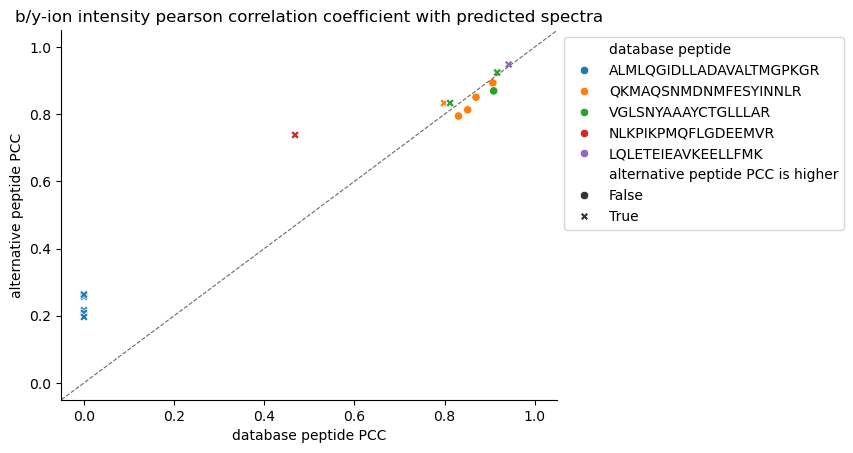

In [83]:
#plot

data=comb_datasets_ncpsm_altpepcomb[(comb_datasets_ncpsm_altpepcomb.isBestPCC)]
#sort by n of psms with isoSAAV
data=data.set_index("database_peptide").loc[a.index].reset_index()
fig, ax = plt.subplots()
g=sns.scatterplot(ax=ax, data=data, x="database_peptide_PCC", y="PCC", style="peptides_w1sub_isBetter", hue="database_peptide",legend=True)
sns.move_legend(g, "upper left", bbox_to_anchor=(1, 1))
ax.axline([0, 0], [1, 1], linewidth=0.8, linestyle="--",color="dimgrey")
ax.set_title("b/y-ion intensity pearson correlation coefficient with predicted spectra")
ax.set_xlabel("database peptide PCC")
ax.set_ylabel("alternative peptide PCC")
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
# Change section titles in the legend
legend = ax.get_legend()

# Grab all legend text items
legend_texts = legend.get_texts()

# Change the legend section titles (these are typically the first text items)
legend_texts[0].set_text("database peptide")
legend_texts[len(data["database_peptide"].unique()) + 1].set_text("alternative peptide PCC is higher")

plt.savefig(f"{figsave_folder}F5B_isosaav_pcc.svg", bbox_inches = 'tight')

In [84]:
#are any of these alternative peptides annotated in OpenProt? how annotation changes?

data=comb_datasets_ncpsm_altpepcomb[(comb_datasets_ncpsm_altpepcomb.isBestPCC)]
d=comb_datasets_ncpsm_altpepcomb.apply(lambda x: insituPEP[insituPEP.peptide==x["peptides_w1sub"]][["peptide_class","protein"]], axis=1)
comb_datasets_ncpsm_altpepcomb["peptide_w1sub_peptide_class"]=d.apply(lambda x: "new" if len(x)==0 else x.peptide_class.iloc[0])
comb_datasets_ncpsm_altpepcomb["peptide_w1sub_protein"]=d.apply(lambda x: "-" if len(x)==0 else x.protein.iloc[0] if len(x)==1 else "indistinguashable proteins")

In [85]:
#summary table
#ntot of psms (in x dataset?), n psm with isoSAAV, n altpep, n psm with better score, alternative pep modified, new annotation peptide class

altpep_summary=pd.DataFrame(columns=["noncanonical_database_peptide","noncanonical_protein","n_psm_total"])
a=comb_datasets_ncpsm_altpepcomb.drop_duplicates("spectrum_title")["database_peptide"].value_counts()
altpep_summary["noncanonical_database_peptide"]=a.index
altpep_summary["noncanonical_protein"]=altpep_summary.noncanonical_database_peptide.apply(lambda x: comb_datasets_ncpsm_altpepcomb[comb_datasets_ncpsm_altpepcomb.database_peptide==x].leadprot.iloc[0])
altpep_summary["n_psm_wisoSAAV"]=a.values
b=comb_datasets_ncpsm_altpepcomb.drop_duplicates("database_peptide")[["database_peptide",'fraction_psm_wsub']]
b.set_index("database_peptide",inplace=True)
b=pd.DataFrame(b.loc[a.index])
altpep_summary["n_psm_total"]=altpep_summary.apply(lambda x: int(round(x["n_psm_wisoSAAV"]/b.loc[x["noncanonical_database_peptide"]].fraction_psm_wsub)),axis=1)
altpep_summary["n_datasets"]=altpep_summary.noncanonical_database_peptide.apply(lambda x: len(comb_datasets_ncpsm_altpepcomb[comb_datasets_ncpsm_altpepcomb.database_peptide==x].dataset.unique()))
altpep_summary["n_altpep_total"]=altpep_summary.noncanonical_database_peptide.apply(lambda x: len(comb_datasets_ncpsm_altpepcomb[comb_datasets_ncpsm_altpepcomb.database_peptide==x].peptides_w1sub.unique()))
altpep_summary["n_psm_altpep_better"]=altpep_summary.noncanonical_database_peptide.apply(lambda x: len(comb_datasets_ncpsm_altpepcomb[(comb_datasets_ncpsm_altpepcomb.database_peptide==x)&(comb_datasets_ncpsm_altpepcomb.peptides_w1sub_isBetter)].spectrum_title.unique()))
altpep_summary["fraction_psm_altpep"]=round(altpep_summary.n_psm_altpep_better/altpep_summary.n_psm_total,2)
altpep_summary["pcc_delta_mean"]=altpep_summary.apply(lambda x: "-" if x["n_psm_altpep_better"]==0 else comb_datasets_ncpsm_altpepcomb[(comb_datasets_ncpsm_altpepcomb.database_peptide==x["noncanonical_database_peptide"])&(
    comb_datasets_ncpsm_altpepcomb.peptides_w1sub_isBetter)].pcc_delta.mean(), axis=1)
altpep_summary["altpep_peptide_class"]=altpep_summary.apply(lambda x: "-" if x["n_psm_altpep_better"]==0 else comb_datasets_ncpsm_altpepcomb[(comb_datasets_ncpsm_altpepcomb.database_peptide==x["noncanonical_database_peptide"])&(
    comb_datasets_ncpsm_altpepcomb.peptides_w1sub_isBetter)].peptide_w1sub_peptide_class.iloc[0], axis=1)
altpep_summary["altpep_protein"]=altpep_summary.apply(lambda x: "-" if x["n_psm_altpep_better"]==0 else comb_datasets_ncpsm_altpepcomb[(comb_datasets_ncpsm_altpepcomb.database_peptide==x["noncanonical_database_peptide"])&(
    comb_datasets_ncpsm_altpepcomb.peptides_w1sub_isBetter)].peptide_w1sub_protein.iloc[0], axis=1)
altpep_summary["altpep_usi"]=altpep_summary.apply(lambda x: "-" if x["n_psm_altpep_better"]==0 else comb_datasets_ncpsm_altpepcomb[(comb_datasets_ncpsm_altpepcomb.database_peptide==x["noncanonical_database_peptide"])&(
    comb_datasets_ncpsm_altpepcomb.peptides_w1sub_isBetter)].peptides_w1sub_USI.iloc[0], axis=1)

#how to explain shared alt peptides? PCC delta is very small, so probably other ionbot functions discarded it 

In [86]:
altpep_summary.to_excel("ionbot_open_noncanon_psm_hpp_pass_altpep_summary.xlsx")

In [87]:
altpep_summary[["n_psm_altpep_better","n_psm_wisoSAAV"]].sum()

n_psm_altpep_better    10
n_psm_wisoSAAV         15
dtype: int64

In [102]:
comb_datasets_ncpsm_altpepcomb[comb_datasets_ncpsm_altpepcomb.database_peptide=="ALMLQGIDLLADAVALTMGPKGR"].dataset.unique()

array(['PXD005833.v0.11.4'], dtype=object)

In [103]:
comb_datasets_ncpsm_altpepcomb[comb_datasets_ncpsm_altpepcomb.database_peptide=="ALMLQGIDLLADAVALTMGPKGR"].spectrum_file.unique()

array(['AM19.mgf', 'AM17.mgf', 'AM21.mgf', 'AM15.mgf'], dtype=object)

In [105]:
comb_datasets_ncpsm_altpepcomb[comb_datasets_ncpsm_altpepcomb.database_peptide=="ALMLQGIDLLADAVALTMGPKGR"].scan.unique()


array([30203, 29427, 29436, 29504, 29681], dtype=object)

In [110]:
comb_datasets_ncpsm_altpepcomb[comb_datasets_ncpsm_altpepcomb.database_peptide=="ALMLQGIDLLADAVALTMGPKGR"].scan.unique()

array([30203, 29427, 29436, 29504, 29681], dtype=object)

In [88]:
altpep_summary #carefull USI is for only one spectra

,noncanonical_database_peptide,noncanonical_protein,n_psm_total,n_psm_wisoSAAV,n_datasets,n_altpep_total,n_psm_altpep_better,fraction_psm_altpep,pcc_delta_mean,altpep_peptide_class,altpep_protein,altpep_usi
0,ALMLQGIDLLADAVALTMGPKGR,IP_761691,5,5,1,2,5,1.00,0.201091,new,-,mzspec:PXD005833:ALMLQGIDLLSDAVALTM[+15.9949]G...
1,QKMAQSNMDNMFESYINNLR,IP_602534,6,5,1,1,1,0.17,0.034331,new,-,mzspec:PXD005833:QKM[+15.9949]SQSNM[+15.9949]D...
2,VGLSNYAAAYCTGLLLAR,IP_735559,4,3,1,1,2,0.50,0.014203,shared_btw_can_noncan,indistinguashable proteins,mzspec:PXD014258:VGLT[+14.0157]NYAAAYC[+57.021...
3,NLKPIKPMQFLGDEEMVR,IP_775497,1,1,1,1,1,1.00,0.269683,new,-,mzspec:PXD014258:NLKPIKPTQFLGDEEM[-29.9928]VR/3
4,LQLETEIEAVKEELLFMK,IP_601994,1,1,1,1,1,1.00,0.005689,new,-,mzspec:PXD014258:LQLETEIES[+13.9793]VKEELLFM[+...


In [89]:
altpep_summary.to_csv("altpep_summary_nc_hpp.txt",sep="\t")

In [93]:
#comb_datasets_ncpsm_altpepcomb[(comb_datasets_ncpsm_altpepcomb.database_peptide.isin(altpep_summary["noncanonical_database_peptide"].tolist()))&(
#    comb_datasets_ncpsm_altpepcomb.peptides_w1sub_isBetter)]

In [94]:
#is any of these PSMs in a set of best scoring psms that went to manual spectra examination?

data=comb_datasets_ncpsm_altpepcomb[(comb_datasets_ncpsm_altpepcomb.isBestPCC)]
for i,row in data.iterrows():
    data.loc[i,"isVis"]= f"{row['spectrum_file'].split('.')[0]}|{row['scan']}" in PCC_dict

/tmp/ipykernel_1072960/1449236663.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data.loc[i,"isVis"]= f"{row['spectrum_file'].split('.')[0]}|{row['scan']}" in PCC_dict


In [95]:
#they have to be ignored in evaluation (indicate in evaluation table)

data.drop_duplicates("spectrum_title").isVis.value_counts()

isVis
False    10
True      5
Name: count, dtype: int64

In [96]:
data[data.isVis].spectrum_title.unique()

array(['AM19:controllerType=0 controllerNumber=1 scan=30203',
       'ESC-HF-Sample-MCF5:controllerType=0 controllerNumber=1 scan=22040',
       'ESC-HF-Sample-BT474_1:controllerType=0 controllerNumber=1 scan=13639',
       'AM20:controllerType=0 controllerNumber=1 scan=22736',
       'ESC-HF-Sample-BT474_2:controllerType=0 controllerNumber=1 scan=19212'],
      dtype=object)

In [97]:
#check the MS2PIP for 24032
ms2pip_predictions[ms2pip_predictions.spec_id==24032]

,spec_id,charge,ion,ionnumber,mz,prediction,rt
2184,24032,2,b,1,100.076,0.000000,54.6761
2185,24032,2,b,2,213.160,0.091718,54.6761
2186,24032,2,b,3,327.203,0.029792,54.6761
2187,24032,2,b,4,441.246,0.023497,54.6761
2188,24032,2,b,5,585.299,0.014279,54.6761
2189,24032,2,b,6,714.342,0.009660,54.6761
2190,24032,2,b,7,828.421,0.003474,54.6761
2191,24032,2,b,8,885.442,0.000000,54.6761
2192,24032,2,b,9,986.490,0.000429,54.6761
2193,24032,2,b,10,1073.520,0.000271,54.6761


In [98]:
nc_toexplore[nc_toexplore.scan==24032].proteins

220    TX=9606((21-39))((IP_558630))
Name: proteins, dtype: object

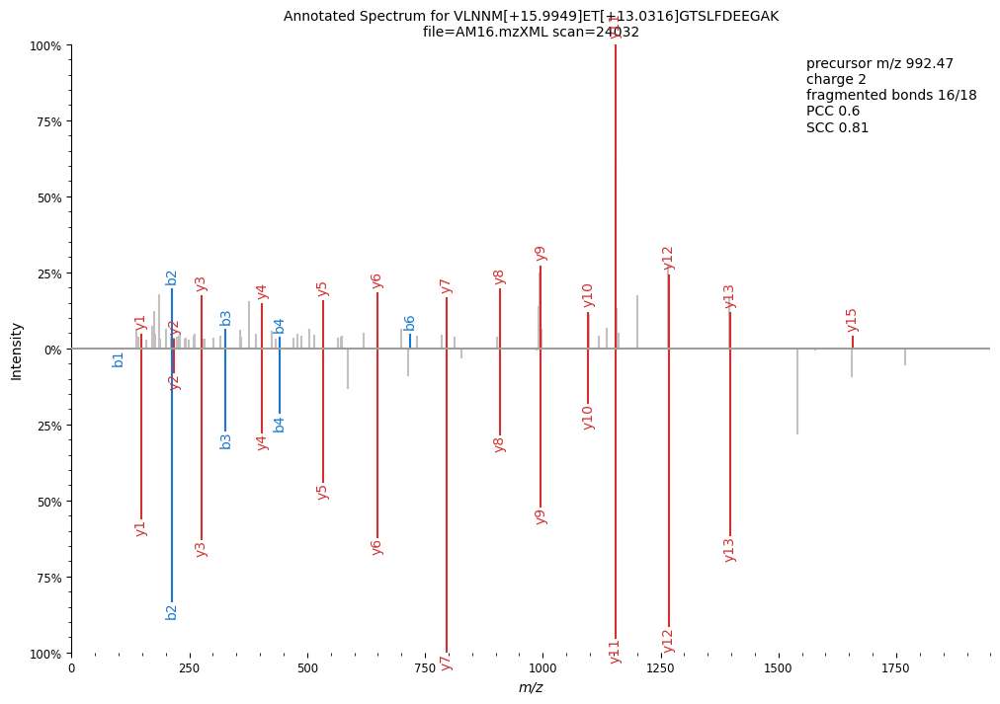

In [99]:
#save 24032 to svg
for key in nc_spectra_dict.keys():
    scan=int(nc_spectra_dict[key]["identifier"])
    if scan!=24032: continue
    ms2pip_spec=ms2pip_predictions[ms2pip_predictions.spec_id==scan]
    plot_mz_min,plot_mz_max=ms2pip_spec.mz.min()-10, ms2pip_spec.mz.max()+10
    # Create the spectrum
    spec = sus.MsmsSpectrum(
        identifier=nc_spectra_dict[key]["identifier"],
        precursor_mz=nc_spectra_dict[key]["precursor_mz"],
        precursor_charge=nc_spectra_dict[key]["precursor_charge"], 
        mz=nc_spectra_dict[key]["mz"],
        intensity=nc_spectra_dict[key]["intensity"],
        retention_time=nc_spectra_dict[key]["retention_time"]
    )

    # Set mz range and filter
    spec = spec.set_mz_range(min_mz=plot_mz_min, max_mz=plot_mz_max)  
    spec = spec.scale_intensity() 


    # Annotate with peptide sequence
    peptide_sequence=nc_toexplore.loc[nc_toexplore.scan==scan,"peptide_spectrum_utils"].iloc[0]
    spec.annotate_proforma(peptide_sequence, 20, "ppm")

    # Create mirrored spectrum
    mirrored_spec = sus.MsmsSpectrum(
        identifier=spec.identifier,
        precursor_mz=spec.precursor_mz,
        precursor_charge=spec.precursor_charge,
        mz=ms2pip_spec.mz.to_numpy(),
        intensity=ms2pip_spec.prediction.to_numpy(),
        retention_time=spec.retention_time
    )

    mirrored_spec = mirrored_spec.set_mz_range(min_mz=plot_mz_min, max_mz=plot_mz_max)  
    mirrored_spec = mirrored_spec.scale_intensity() 
    
    #peptide_sequence_ms2pip=nc_toexplore.loc[nc_toexplore.scan==scan,"database_peptide_x"].iloc[0]
    mirrored_spec.annotate_proforma(peptide_sequence, 20, "ppm")
    
    pcc,spec_merge=PCC(spec,mirrored_spec)
    scc,_=SCC(spec,mirrored_spec)
    pep=nc_toexplore.loc[nc_toexplore.scan==scan,"database_peptide"].iloc[0]
    frb=get_BB(spec_merge,pep)
    
    # Plot original and mirrored spectra
    fig, ax = plt.subplots(figsize=(12, 8))

    # Plot mirrored (bottom)

    sup.mirror(spec, mirrored_spec, ax=ax,spectrum_kws={"grid":False})    
    #sup.facet(spec, spec, mirrored_spec, ax=ax,spectrum_kws={"grid":False})    
    
    info=f'precursor m/z {round(nc_spectra_dict[key]["precursor_mz"],2)}\ncharge {nc_spectra_dict[key]["precursor_charge"]}\nfragmented bonds {frb}/{len(pep)}\nPCC {round(pcc,2)}\nSCC {round(scc,2)}\n'
    ax.text(
        0.80, 0.98,
        info, 
        ha='left', va='top',
        transform=ax.transAxes,
        fontsize=10, color='black',
        bbox=dict(facecolor='white', alpha=0.5, edgecolor='none'))
    
    # Titles and labels
    #peptide_sequence_plot=nc_toexplore.loc[nc_toexplore.scan==scan,"custom_peptide"].iloc[0]
    ax.set_title(f"Annotated Spectrum for {peptide_sequence}\nfile={nc_spectra_dict[key]['mzxml']} scan={scan}",fontsize=10)
    ax.set_xlabel("m/z")
    ax.set_ylabel("Intensity")
    ax.spines['bottom'].set_visible(False)       
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    plt.savefig(f"{figsave_folder}{nc_spectra_dict[key]['mzxml']}_{scan}_spec.svg")

In [ ]:
#---?

In [357]:
#save scan 16188 as svg
for key in nc_spectra_mgf_dict.keys():   
    scan=int(nc_spectra_mgf_dict[key]["identifier"].lstrip("scan="))
    if scan not in [28850,10336]: continue
    print(key)
    ms2pip_spec=ms2pip_spectra[ms2pip_spectra.spec_id==scan]
    plot_mz_min,plot_mz_max=ms2pip_spec.mz.min()-10, ms2pip_spec.mz.max()+10
    # Create the spectrum
    spec = sus.MsmsSpectrum(
        identifier=nc_spectra_mgf_dict[key]["identifier"],
        precursor_mz=nc_spectra_mgf_dict[key]["precursor_mz"],
        precursor_charge=nc_spectra_mgf_dict[key]["precursor_charge"], 
        mz=nc_spectra_mgf_dict[key]["mz"],
        intensity=nc_spectra_mgf_dict[key]["intensity"],
        retention_time=nc_spectra_mgf_dict[key]["retention_time"]
    )

    spec = spec.set_mz_range(min_mz=plot_mz_min, max_mz=plot_mz_max)  
    spec = spec.scale_intensity() 

    peptide_sequence=nc_toexplore.loc[nc_toexplore.scan==scan,"pyteomics_peptide"].iloc[0]
    spec.annotate_proforma(peptide_sequence, 20, "ppm")

    mirrored_spec = sus.MsmsSpectrum(
        identifier=spec.identifier,
        precursor_mz=spec.precursor_mz,
        precursor_charge=spec.precursor_charge,
        mz=ms2pip_spec.mz.to_numpy(),
        intensity=ms2pip_spec.prediction.to_numpy(),
        retention_time=spec.retention_time
    )

    mirrored_spec = mirrored_spec.set_mz_range(min_mz=plot_mz_min, max_mz=plot_mz_max)  
    mirrored_spec = mirrored_spec.scale_intensity() 

    peptide_sequence_ms2pip=nc_toexplore.loc[nc_toexplore.scan==scan,"database_peptide_x"].iloc[0]
    mirrored_spec.annotate_proforma(peptide_sequence_ms2pip, 20, "ppm")
    
    pcc,spec_merge=PCC(spec,mirrored_spec)
    frb=len(set([int(ion.replace("b","").replace("y","")) for ion in spec_merge[spec_merge["0spec"]!=0].index]))
    pep=nc_toexplore.loc[nc_toexplore.scan==scan,"database_peptide_x"].iloc[0]
    
    fig, ax = plt.subplots(figsize=(12, 8))


    sup.mirror(spec, mirrored_spec, ax=ax,spectrum_kws={"grid":False})      
   
    info=f'precursor m/z {round(nc_spectra_mgf_dict[key]["precursor_mz"],2)}\ncharge {nc_spectra_mgf_dict[key]["precursor_charge"]}\nfragmented bonds {frb}/{len(pep)}\nPCC {round(pcc,2)}\n'
    ax.text(
        0.80, 0.98,
        info, 
        ha='left', va='top',
        transform=ax.transAxes,
        fontsize=10, color='black',
        bbox=dict(facecolor='white', alpha=0.5, edgecolor='none'))
    
    # Titles and labels
    peptide_sequence_plot=nc_toexplore.loc[nc_toexplore.scan==scan,"custom_peptide"].iloc[0]
    ax.set_title(f"Annotated Spectrum for {peptide_sequence_plot}\nfile={nc_spectra_mgf_dict[key]['mgf']} scan={scan}",fontsize=10)
    ax.set_xlabel("m/z")
    ax.set_ylabel("Intensity")
    ax.spines['bottom'].set_visible(False)       
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    plt.savefig(f"{nc_spectra_mgf_dict[key]['mgf']}_{scan}_spec.svg")

NameError: name 'nc_spectra_mgf_dict' is not defined

In [ ]:
###----old-------------

In [4]:
nc_toexplore=pd.read_excel("nc_toexplose_novar_msm_bests.xlsx")

In [5]:
nc_toexplore.loc[nc_toexplore.dataset=="PXD003594","spectrum_file_x"]=nc_toexplore.loc[nc_toexplore.dataset=="PXD003594","spectrum_file_x"].str.replace('.raw', '.mgf')
nc_toexplore.loc[nc_toexplore.dataset=="PXD014258","spectrum_file_x"]=nc_toexplore.loc[nc_toexplore.dataset=="PXD014258","spectrum_file_x"].str.replace('.RAW.raw','.mgf')
nc_toexplore.loc[nc_toexplore.dataset=="PXD002057","spectrum_file_x"]=nc_toexplore.loc[nc_toexplore.dataset=="PXD002057","spectrum_file_x"].str.replace('.raw','.mgf')

In [6]:
nc_toexplore["unimod_peptide"]=nc_toexplore.USI.apply(lambda x: ":".join(x.split(":")[5:]).split("/")[0])

In [7]:
nc_toexplore["unimod_peptide"].iloc[0]

'[UNIMOD:1]-AAK[UNIMOD:381]ALDRHQAHLC[UNIMOD:4]VLASNC[UNIMOD:4]DEPMYVK'

In [8]:
#find weird UNIMOD
#substitute:
unimod_fix={"9999989]":"1680]",
           "999928]":"536]",
           "9999111]":"1427]",
           "9999248]":"1450]",
           "9999986]":"1614]",
           "999990]":"60]",
           "9999936]":"1765]",
           "9999317]":"1763]",
           "9999575]":"285]",
           "9999833]":"1378]",
           "9999365]":"1599]",
           "9999805]":"1691]",
           "9999571]":"65]",
           "9999471]":"41]",
           "9999800]":"1377]",
           "9999558]":"1413]",
           "9999481]":"1434]",
           "9999212]":"1935]",
           "9999211]":"1441]",
           "99991]":"365]",
           "9999529]":"1368]",
           "9999122]":"149]",
           "9999999]":"1654]",
           "9999761]":"1596]",
           "9999363]":"1599]",
           "9999297]":"1932]",
           "9999292]":"1936]",
           "9999210]":"1441]",
           "9999126]":"1786]",
           "9999124]":"149]"}
for i,row in nc_toexplore.iterrows():
    s=row["unimod_peptide"]
    for k,v in unimod_fix.items():
        s=s.replace(k,v)
    nc_toexplore.loc[i,"unimod_peptide"]=s

In [46]:
nc_toexplore.loc[nc_toexplore.dataset=="PXD014258","spectrum_file_x"]=nc_toexplore.loc[nc_toexplore.dataset=="PXD014258","spectrum_file_x"].apply(lambda x: x.replace(".mgf",".RAW.mgf"))

scan=12293 130327_o2_01_hu_C1_2hr [UNIMOD:1]-AAK[UNIMOD:381]ALDRHQAHLC[UNIMOD:4]VLASNC[UNIMOD:4]DEPMYVK 4 PXD002057 0
130327_o2_01_hu_C1_2hr.12293.12293.4 File:"130327_o2_01_hu_C1_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=12293"
scan=34011 130327_o2_01_hu_C1_2hr AC[UNIMOD:4]AIGILM[UNIMOD:35]KDLAGELALVDVMEDK 3 PXD002057 1
130327_o2_01_hu_C1_2hr.34011.34011.3 File:"130327_o2_01_hu_C1_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=34011"
scan=21058 130327_o2_06_hu_P3_2hr ADASSTS[UNIMOD:977]SFLDSDELER 2 PXD002057 2
130327_o2_06_hu_P3_2hr.21058.21058.2 File:"130327_o2_06_hu_P3_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=21058"
scan=20421 130327_o2_04_hu_P2_2hr AEISEMNRNISWLQAEIEGLKGQR 4 PXD002057 3
130327_o2_04_hu_P2_2hr.20421.20421.4 File:"130327_o2_04_hu_P2_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=20421"
scan=22519 130327_o2_04_hu_P2_2hr AENGKLVINENPIT[UNIMOD:1680]IFQERDPSK 3 PXD002057 4
130327_o2_04_hu_P2_2hr.22519.225

C:\Users\vasv1101\AppData\Local\Temp\ipykernel_151244\1975416505.py:69: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(12, 6))


scan=19213 130327_o2_05_hu_C3_2hr IEGEIIVC[UNIMOD:4]AAYAHELPK 3 PXD002057 21
130327_o2_05_hu_C3_2hr.19213.19213.3 File:"130327_o2_05_hu_C3_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=19213"
scan=25521 130327_o2_06_hu_P3_2hr IEM[UNIMOD:35]ELRDISNDVLSLLEK 2 PXD002057 22
130327_o2_06_hu_P3_2hr.25521.25521.2 File:"130327_o2_06_hu_P3_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=25521"
scan=22921 130327_o2_01_hu_C1_2hr IGIVDQSQQAYQEAFEISKK 2 PXD002057 23
130327_o2_01_hu_C1_2hr.22921.22921.2 File:"130327_o2_01_hu_C1_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=22921"
scan=7412 130327_o2_01_hu_C1_2hr [UNIMOD:39]-IGVHHYSGNNIELGTAC[UNIMOD:4]GK 2 PXD002057 24
130327_o2_01_hu_C1_2hr.7412.7412.2 File:"130327_o2_01_hu_C1_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=7412"
scan=11052 130327_o2_06_hu_P3_2hr ILK[UNIMOD:903]EGGYSFTTTAER 3 PXD002057 25
130327_o2_06_hu_P3_2hr.11052.11052.3 File:"130327_o2_06_hu_P3_2hr.raw", NativeID:"controll

scan=15933 130327_o2_04_hu_P2_2hr SGDAAIVDM[UNIMOD:35]VPGKPVYVESFSDYPPLGR 3 PXD002057 58
130327_o2_04_hu_P2_2hr.15933.15933.3 File:"130327_o2_04_hu_P2_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=15933"
scan=27729 130327_o2_06_hu_P3_2hr SLDM[UNIMOD:35]DNTIAEVK 3 PXD002057 59
130327_o2_06_hu_P3_2hr.27729.27729.3 File:"130327_o2_06_hu_P3_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=27729"
scan=25205 130327_o2_05_hu_C3_2hr SVFIKNSSY[UNIMOD:1255]VILKADQLTEEQIAEFK 4 PXD002057 60
130327_o2_05_hu_C3_2hr.25205.25205.4 File:"130327_o2_05_hu_C3_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=25205"
scan=19273 130327_o2_05_hu_C3_2hr SYELPDDQVITIDNER 2 PXD002057 61
130327_o2_05_hu_C3_2hr.19273.19273.2 File:"130327_o2_05_hu_C3_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=19273"
scan=22143 130327_o2_06_hu_P3_2hr T[UNIMOD:122]IVAIENPADVSVISSR 2 PXD002057 62
130327_o2_06_hu_P3_2hr.22143.22143.2 File:"130327_o2_06_hu_P3_2hr.raw", NativeID:"co

controllerType=0 controllerNumber=1 scan=17234
scan=8077 b1369p080_sample_01_a YEELQAL[UNIMOD:35]AGK 2 PXD003594 110
controllerType=0 controllerNumber=1 scan=8077
scan=3789 b1369p080_sample_07_b YLAEVAAGDGKK[UNIMOD:6] 2 PXD003594 111
controllerType=0 controllerNumber=1 scan=3789
scan=16188 b1369p080_sample_06_a YPIKHG[UNIMOD:420]IVTNWDDMEK 3 PXD003594 112
controllerType=0 controllerNumber=1 scan=16188
scan=22232 ESC-HF-Sample-MCF4 [UNIMOD:1]-AEEGIAAGGI[UNIMOD:425]R[UNIMOD:425]D[UNIMOD:421]V[UNIMOD:425]TTALQEVLK 2 PXD014258 113
controllerType=0 controllerNumber=1 scan=22232
scan=20030 ESC-HF-Sample-BT474_5 AIATGGAVFGEEGLT[UNIMOD:1843]LNLEDVQPHDLGK 4 PXD014258 114
controllerType=0 controllerNumber=1 scan=20030
scan=23498 ESC-HF-Sample-BT474_5 ALM[UNIMOD:35]LQGIDLLADAVALTM[UNIMOD:35]GPK 3 PXD014258 115
controllerType=0 controllerNumber=1 scan=23498
scan=18576 ESC-HF-Sample-BT474_2 C[UNIMOD:4]RAS[UNIMOD:1441]LLLQT[UNIMOD:1441]T[UNIMOD:1441]VHAIT[UNIMOD:1441]AT[UNIMOD:1441]QKTVDGPSGK 4 PXD0

scan=13350 ESC-HF-Sample-MCF4 LVEALC[UNIMOD:4][UNIMOD:4]AE[UNIMOD:1827]HQIDLIKVDDNKK 4 PXD014258 170
controllerType=0 controllerNumber=1 scan=13350
scan=13521 ESC-HF-Sample-BT474_5 LVQDVANNTNEETGDGPTTATVLAR 3 PXD014258 171
controllerType=0 controllerNumber=1 scan=13521
scan=8703 ESC-HF-Sample-MCF4 [UNIMOD:1]-M[UNIMOD:35]AAC[UNIMOD:4][UNIMOD:4][UNIMOD:4]M[UNIMOD:35]KSVTKQGAELSNEER 2 PXD014258 172
controllerType=0 controllerNumber=1 scan=8703
scan=15045 ESC-HF-Sample-MCF5 [UNIMOD:1]-M[UNIMOD:35]AC[UNIMOD:4][UNIMOD:4]ARLLISVYSESGESSGKNVTLPAVFK 2 PXD014258 173
controllerType=0 controllerNumber=1 scan=15045
scan=20790 ESC-HF-Sample-MCF5 M[UNIMOD:35]AVT[UNIMOD:926]FIGS[UNIMOD:926]S[UNIMOD:926]T[UNIMOD:926]AIQELFK 3 PXD014258 174
controllerType=0 controllerNumber=1 scan=20790
scan=9602 ESC-HF-Sample-MCF5 MDSTEPPYSQK[UNIMOD:1368]REEEIVK 3 PXD014258 175
controllerType=0 controllerNumber=1 scan=9602
scan=8789 ESC-HF-Sample-BT474_2 M[UNIMOD:35][UNIMOD:35]NHEKYDNSLKIVSNASC[UNIMOD:4][UNIMOD:4]TTNC[

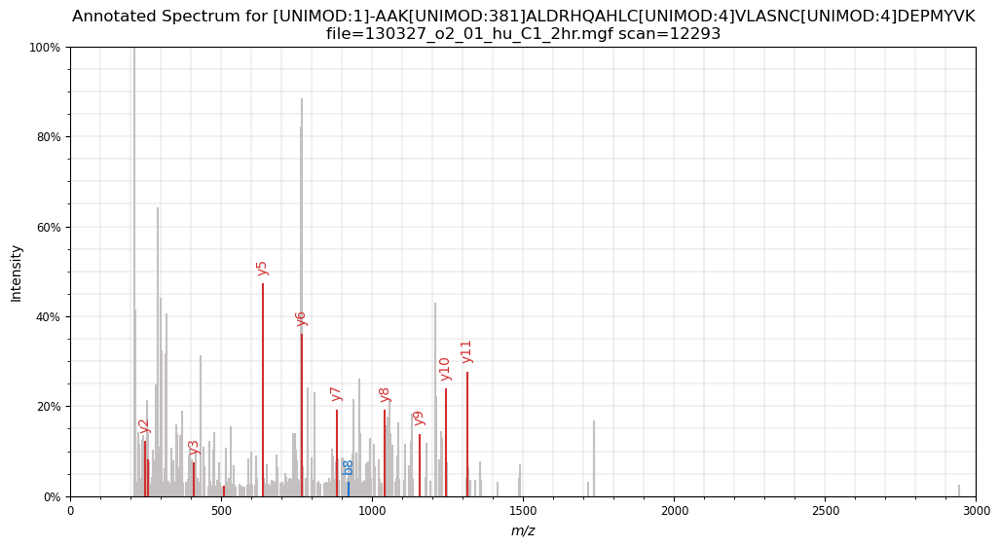

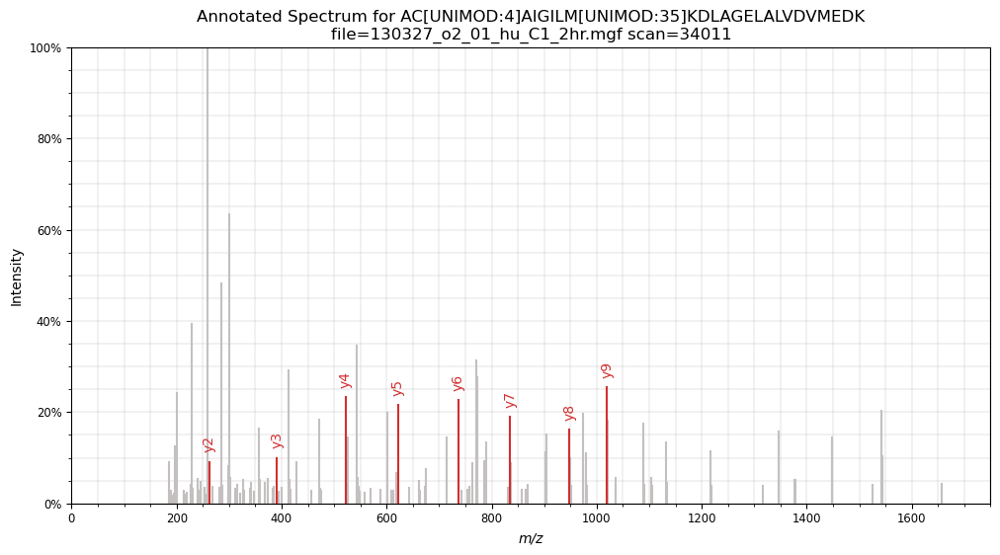

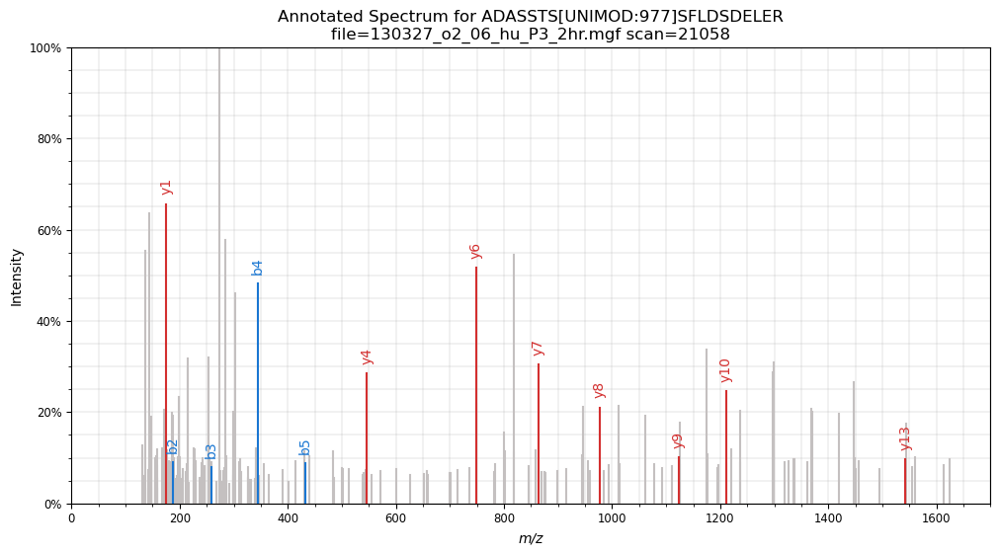

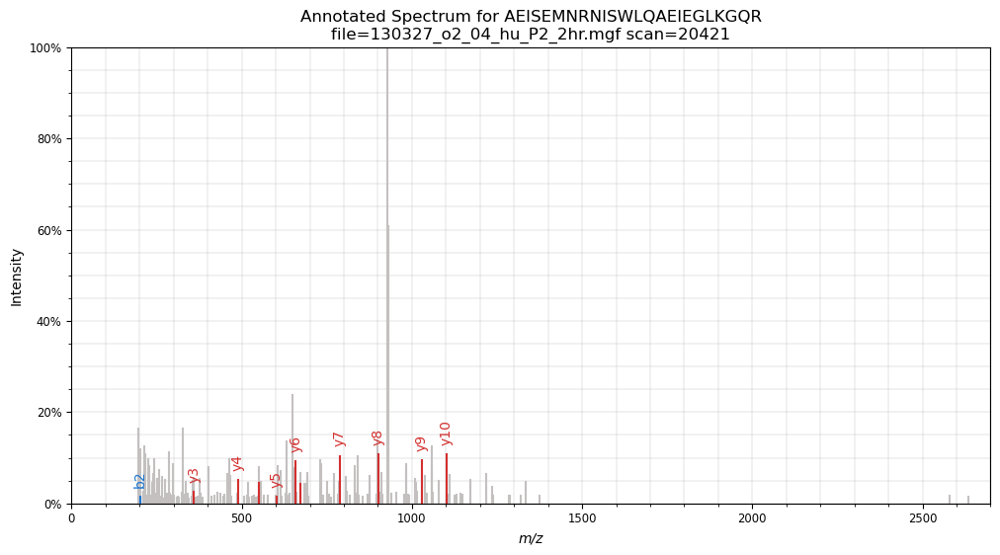

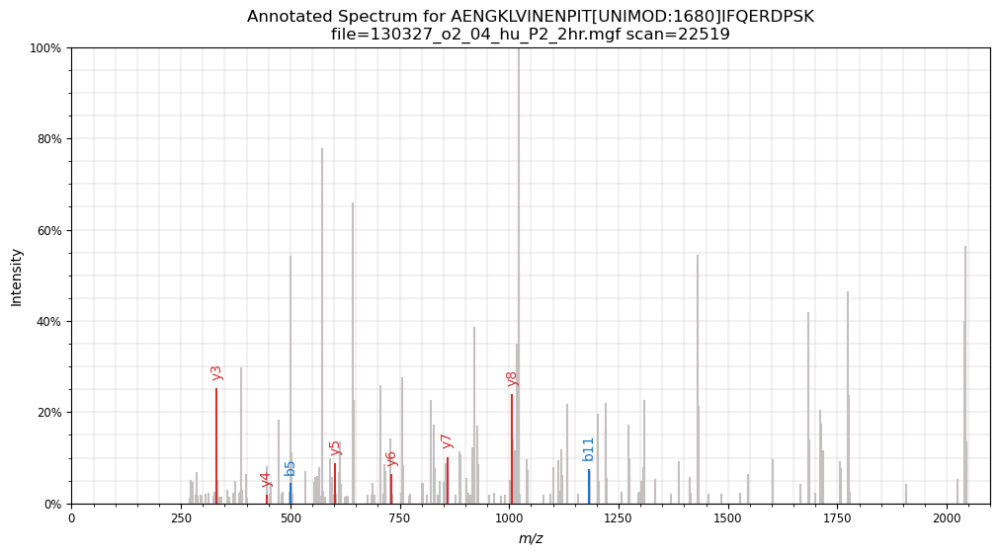

...

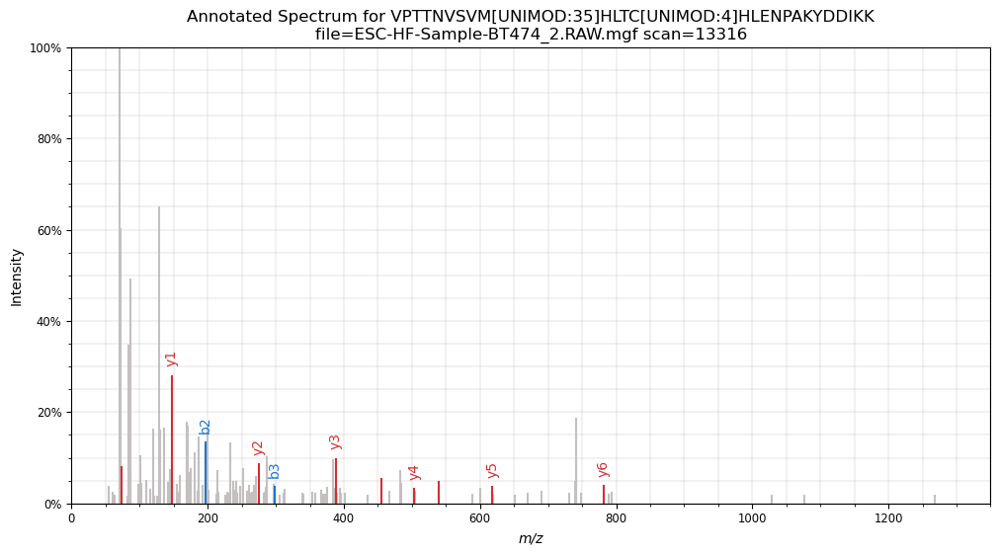

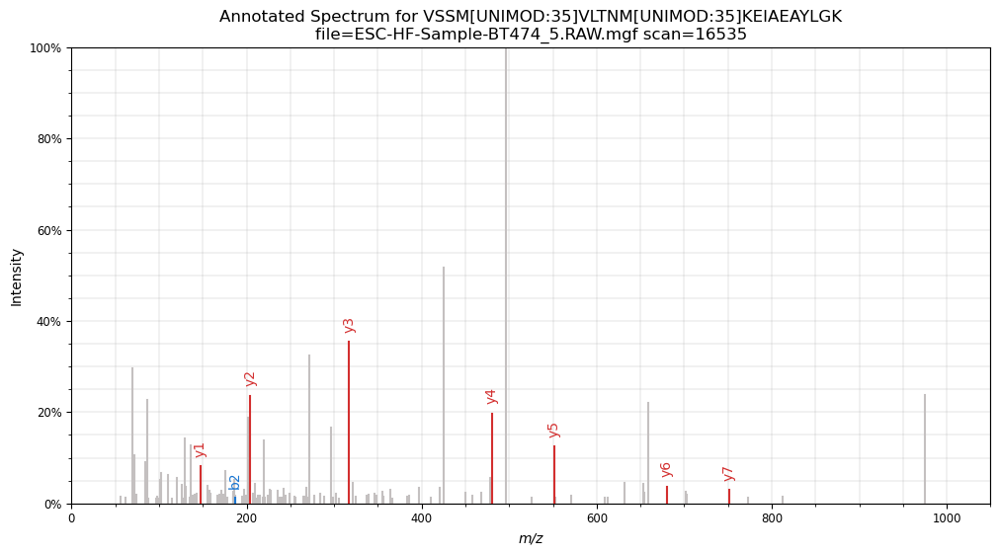

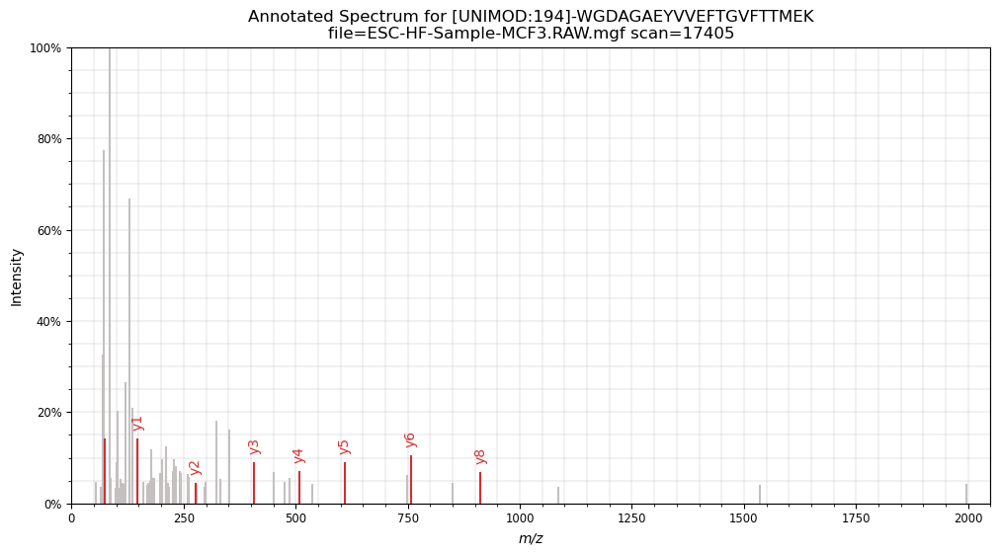

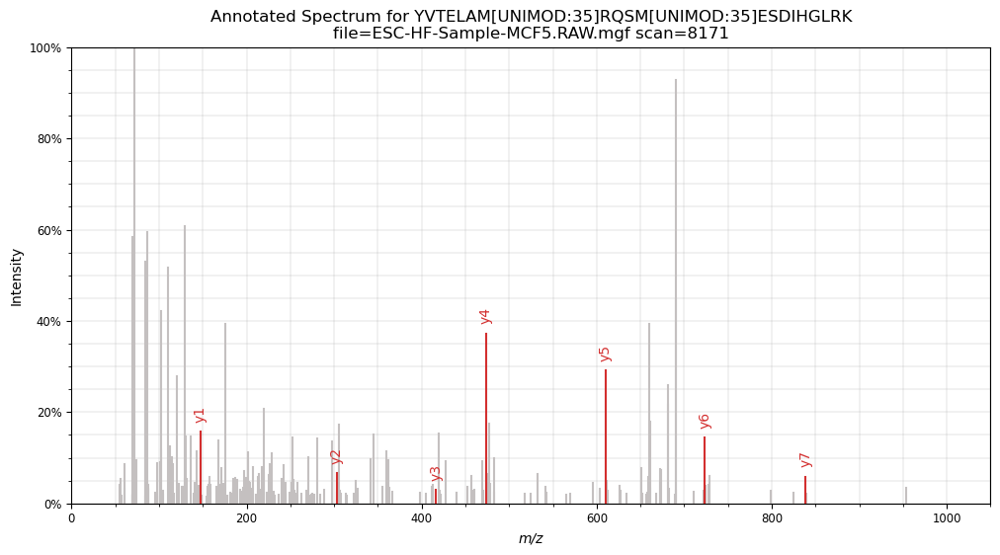

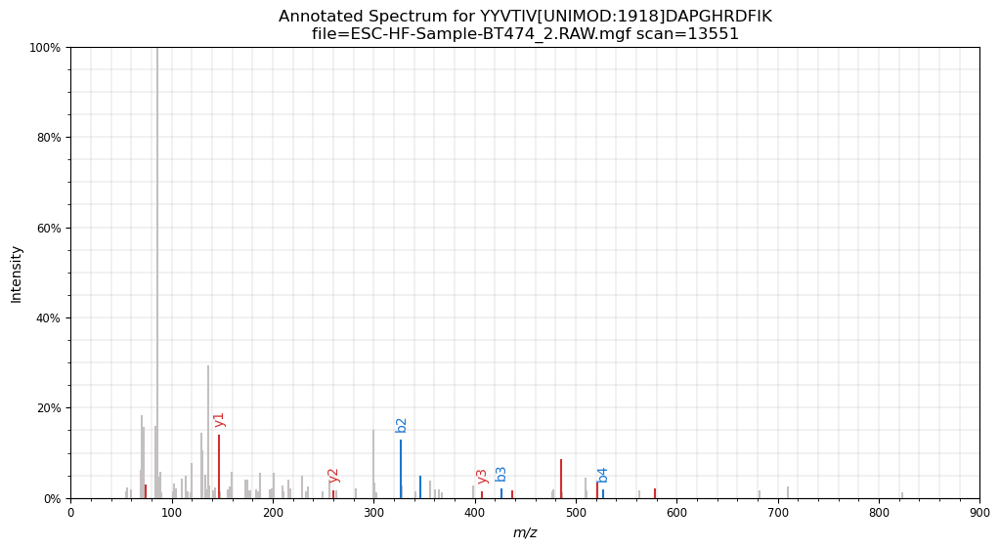

In [58]:
#PROBABLY I INCORRECTLY PASSED THE MODIFICATION PARSING TO PEPTIDE SEQUENCE
#- REVISE https://pyteomics.readthedocs.io/en/latest/api/parser.html#pyteomics.parser.to_proforma
pdf = matplotlib.backends.backend_pdf.PdfPages("nc_HPPpass_best_psms_v2.pdf")
nc_spectra_dict={}
for i,row in nc_toexplore.iterrows():
    #if i<181: continue
    target_title=f"scan={row['scan']}"
    target_file=row["spectrum_file_x"].split(".")[0]
    peptide_sequence=row["unimod_peptide"]
    set_charge=row["charge"]
    dataset=row["dataset"]
    mgf_file =row["spectrum_file_x"] 
    spectra = mgf.read(os.path.join(mgf_folder,dataset,mgf_file)) #read each time againe
    print(target_title, target_file, peptide_sequence,set_charge,dataset, i)
    # Parse the MGF file and find the matching spectrum
    for spectrum in spectra:
        if target_title in spectrum['params']['title']: 
            print(spectrum['params']['title'])
            mz_values = np.array(spectrum['m/z array'])
            intensities = np.array(spectrum['intensity array'])
            precursor_mz = float(spectrum['params'].get('pepmass', [0])[0])

            # Ensure charge is an integer
            charge = spectrum['params'].get('charge', [set_charge])
            if isinstance(charge, list):  # Some MGF files store charge as a list
                try:
                    charge = charge[charge.index(set_charge)]
                except ValueError:
                    charge = charge[0] #if no ionbot charge in list, then take first
            precursor_charge = int(charge)  # Convert to int explicitly

            retention_time = float(spectrum['params'].get('rtinseconds', float('nan')))
            
            nc_spectra_dict[spectrum['params']['title']]={
                "mgf":mgf_file,
                "identifier":target_title,
                "precursor_mz":precursor_mz,
                "precursor_charge":precursor_charge,  # Ensure it's an int
                "charge from ionbot":set_charge,
                "mz":mz_values,
                "intensity":intensities,
                "retention_time":retention_time
            }
            
            # Create an MsmsSpectrum object with the updated constructor
            spec = sus.MsmsSpectrum(
                identifier=target_title,
                precursor_mz=precursor_mz,
                precursor_charge=precursor_charge,  # Ensure it's an int
                mz=mz_values,
                intensity=intensities,
                retention_time=retention_time
            )

            # Preprocess the spectrum
            spec = spec.set_mz_range(min_mz=np.min(mz_values)-10, max_mz=np.max(mz_values)+10)  # Limit m/z range #how ?
            spec = spec.scale_intensity()  # Normalize intensity
            spec = spec.filter_intensity(0.01)  # Filter low-intensity peaks

            # Annotate the spectrum with the given peptide sequence
            spec.annotate_proforma(peptide_sequence, 20, "ppm")

            # Plot the annotated spectrum
            fig, ax = plt.subplots(figsize=(12, 6))
            sup.spectrum(spec, ax=ax)
            plt.title(f"Annotated Spectrum for {peptide_sequence}\nfile={mgf_file} {target_title}")
            #plt.show()
            pdf.savefig(fig)
            break  # Stop searching after finding the correct spectrum

            break  # Stop searching after finding the correct spectrum
    else:
        print("Spectrum not found.", target_title, target_file, dataset, charge, i)
pdf.close()

In [57]:
#pdf.close()

In [59]:
#with open('nc_spectra_mgf_dict.pickle', 'wb') as handle:
    pickle.dump(nc_spectra_dict, handle, protocol=pickle.HIGHEST_PROTOCOL)

In [78]:
nc_spectra_mgf_dict=pickle.load(open('nc_spectra_mgf_dict.pickle', 'rb'))

In [ ]:
#Mirrored way of visualisation, corrected modifications encodings

In [ ]:
#peprec
#peptide1 - ACDE 2
#peptide2 2|Carbamidomethyl ACDEFGHI 3
#peptide3 0|iTRAQ|10|Oxidation ACDEFGHIKMNPQ 2
#modification list
#Oxidation,15.994915,M

In [143]:
columns=["spec_id", "modifications", "peptide", "charge"]
nc_toexplore_peprec=pd.DataFrame(columns=columns)
nc_toexplore_mods=pd.DataFrame(columns=[0,1,2])
for i,row in nc_toexplore.iterrows():
    mods=row["modifications_x"]
    #print(mods)
    mods_peprec=[f"{m.split('|')[0]}|{m.split(']')[1].split('[')[0]}" if m!='Unmodified' else '-' for m in mods.split("||")]
    #print("|".join(set(mods)))
    nc_toexplore_peprec.loc[len(nc_toexplore_peprec)]=[row["scan"],"|".join(set(mods_peprec)),row["database_peptide_x"],row["charge"]]
    mods_mods=[f"{m.split(']')[1].split('[')[0]},*,{m.split(']')[1].split('[')[1].rstrip(']')}" for m in mods.split("||")  if m!='Unmodified']
    for m in mods_mods:
        nc_toexplore_mods.loc[len(nc_toexplore_mods)]=m.split(",")

In [ ]:
nc_toexplore_peprec.to_csv("nc_toexplore_peprec.csv",index=False)

In [146]:
nc_toexplore_mods.drop_duplicates(inplace=True)

In [191]:
#dounload unimod.xml on 09.02.2025 (v2) https://www.unimod.org/downloads.html
with open('unimod.xml') as topo_file:
    topo_lines = topo_file.readlines()
    for i,row in nc_toexplore_mods.iterrows():   
        #print(row[0])
        k=0; found=False
        for j,line in enumerate(topo_lines):            
            if f'title="{row[0]}"' in line:
                #print(line)
                
                while found==False:
                    #print(topo_lines[j+k])
                    if "<umod:delta" in topo_lines[j+k]:
                        found=True
                        #print(topo_lines[j+k])
                        mass_line=topo_lines[j+k]
                        mass_num=float(mass_line.lstrip('<umod:delta mono_mass="').split(" ")[0].rstrip('"'))
                        #print(mass_num)
                    k+=1
                nc_toexplore_mods.loc[i,1]=mass_num
                break
        if found==False:
            print("not found",i,row[0])
    
topo_file.close()

not found 3 Lys->AminoadipicAcid
not found 5 Hydroxylation
not found 30 Cation:Ni:II:
not found 31 Cation:Ni:II:
not found 43 Lys->CamCys
not found 100 Cation:Al:III:
not found 130 Glu->pyro-Glu+Methyl:2H(2)13C(1)
not found 133 Succinyl_2H(4)
not found 137 Met->Hse
not found 205 Carboxy->Thiocarboxy
not found 232 Glu->pyro-Glu+Methyl
not found 277 Pro->pyro-Glu
not found 351 Methyl_2H(3)+Acetyl_2H(3)
not found 373 Pro->Pyrrolidinone
not found 395 Cation:Fe:III:


In [196]:
#Cation:Ni[II], Cation:Al[III], Succinyl:2H(4), Methyl:2H(3)+Acetyl:2H(3)
#Cation:Fe[III]
fill_manualy=[14.96328,63.998285,55.919696,55.919696,
             31.935685,23.958063,-0.979006,104.041151,
             -29.992806,15.977156,-0.979006,13.979265,
             62.063875,-30.010565,52.911464]
nc_toexplore_mods.loc[nc_toexplore_mods[1]=="*",1]=fill_manualy

In [199]:
nc_toexplore_mods.to_csv("nc_toexplore_mods.csv",index=False)

In [211]:
#run MS2PIP on server 09-03-2025
ms2pip_spectra=pd.read_csv("ms2pip_predictions.csv")
ms2pip_spectra["ion"].replace("B","b",inplace=True)
ms2pip_spectra["ion"].replace("Y","y",inplace=True)

In [212]:
ms2pip_spectra.columns

Index(['spec_id', 'charge', 'ion', 'ionnumber', 'mz', 'prediction'], dtype='object')

In [216]:
#def ms2pip_custom_annotate(ms2pip_spec): 
#    annotations = {row["mz"]:f'{row["ion"]}{row["ionnumber"]}' for i,row in ms2pip_spec.iterrows()}    
#    return annotations

#ms2pip_annotations=ms2pip_custom_annotate(ms2pip_spectra[ms2pip_spectra.spec_id==scan])
#for mz, label in ms2pip_annotations.items():
#    spec.annotations.append((mz, label))

In [ ]:
#coreect modifications


In [8]:
def get_modpep(row,ms2pip_mods_df,mode="spectrum_utils"):
    """
    modes: usi 
            '[UNIMOD:1]-AAK[UNIMOD:381]ALDRHQAHLC[UNIMOD:4]VLASNC[UNIMOD:4]DEPMYVK'
            spectrum_utils
            '[+42.010565]-AAK[+14.96328]ALDRHQAHLC[+57.021464]VLASNC[+57.021464]DEPMYVK'
            custom
            
    """
    #print(row)
    peptide=list(row["database_peptide_x"])
    modifications=row["modifications_x"]
    #print(row.modifications)
    if modifications=="Unmodified": return row["database_peptide_x"]
    if mode=="spectrum_utils" or mode=="custom":
        unimod_id=[mods.split("_or_")[0].split(']')[1].split('[')[0] if "_or_" in mods 
                   else mods.split(']')[1].split('[')[0]  
                   for mods in modifications.split("||")]
    elif mode=="usi":
        unimod_id=[mods.split("_or_")[0].split("|")[1].split("]")[0][1:] if "_or_" in mods 
               else mods.split("|")[1].split("]")[0][1:]  
               for mods in modifications.split("||") ]
    positions=[int(mods.split("_or_")[0].split("|")[0]) if "_or_" in mods 
               else int(mods.split("|")[0])  
               for mods in modifications.split("||")]
    i=0
    for pos,unimod_id in sorted(zip(positions, unimod_id), key=lambda pair: pair[0]): #sort by position
        if mode=="spectrum_utils":
            mod_row=ms2pip_mods_df[ms2pip_mods_df[0]==unimod_id].iloc[0]
            #print(mod_row)
            sign="+" if float(mod_row[1])>=0 else ""
            t=f"[{sign}{mod_row[1]}]"
        elif mode=="usi":
            t=f"[UNIMOD:{unimod_id}]"
        elif mode=="custom":
            t=f"({unimod_id})"
        if pos==0: t=t+"-"
        peptide.insert(pos+i,t)
        i+=1 #to correct the position
        #print(t)
    pep="".join(peptide)
    pep=pep.replace("--","-")
    return pep

In [319]:
nc_toexplore["pyteomics_peptide"]=np.nan
nc_toexplore["custom_peptide"]=np.nan
for i,row in nc_toexplore.iterrows():
    nc_toexplore.loc[i,"pyteomics_peptide"]=get_modpep(row,nc_toexplore_mods,"spectrum_utils")
    nc_toexplore.loc[i,"custom_peptide"]=get_modpep(row,nc_toexplore_mods,"custom")

In [320]:
nc_toexplore[["unimod_peptide","pyteomics_peptide","custom_peptide"]].values[0]

array(['[UNIMOD:1]-AAK[UNIMOD:381]ALDRHQAHLC[UNIMOD:4]VLASNC[UNIMOD:4]DEPMYVK',
       '[+42.010565]-AAK[+14.96328]ALDRHQAHLC[+57.021464]VLASNC[+57.021464]DEPMYVK',
       '(Acetyl)-AAK(Lys->AminoadipicAcid)ALDRHQAHLC(Carbamidomethyl)VLASNC(Carbamidomethyl)DEPMYVK'],
      dtype=object)

130327_o2_01_hu_C1_2hr.12293.12293.4 File:"130327_o2_01_hu_C1_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=12293"
130327_o2_01_hu_C1_2hr.34011.34011.3 File:"130327_o2_01_hu_C1_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=34011"
130327_o2_06_hu_P3_2hr.21058.21058.2 File:"130327_o2_06_hu_P3_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=21058"
130327_o2_04_hu_P2_2hr.20421.20421.4 File:"130327_o2_04_hu_P2_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=20421"
130327_o2_04_hu_P2_2hr.22519.22519.3 File:"130327_o2_04_hu_P2_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=22519"
130327_o2_06_hu_P3_2hr.32014.32014.3 File:"130327_o2_06_hu_P3_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=32014"
130327_o2_01_hu_C1_2hr.13864.13864.2 File:"130327_o2_01_hu_C1_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=13864"
130327_o2_04_hu_P2_2hr.21122.21122.4 File:"130327_o2_04_hu_P2_2hr.raw", NativeID:"controll

C:\Users\vasv1101\AppData\Local\Temp\ipykernel_151244\888031803.py:54: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(12, 8))


130327_o2_05_hu_C3_2hr.19213.19213.3 File:"130327_o2_05_hu_C3_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=19213"
130327_o2_06_hu_P3_2hr.25521.25521.2 File:"130327_o2_06_hu_P3_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=25521"
130327_o2_01_hu_C1_2hr.22921.22921.2 File:"130327_o2_01_hu_C1_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=22921"
130327_o2_01_hu_C1_2hr.7412.7412.2 File:"130327_o2_01_hu_C1_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=7412"
130327_o2_06_hu_P3_2hr.11052.11052.3 File:"130327_o2_06_hu_P3_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=11052"
130327_o2_02_hu_P1_2hr.34841.34841.2 File:"130327_o2_02_hu_P1_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=34841"
130327_o2_05_hu_C3_2hr.13799.13799.3 File:"130327_o2_05_hu_C3_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=13799"
130327_o2_01_hu_C1_2hr.16009.16009.3 File:"130327_o2_01_hu_C1_2hr.raw", NativeID:"controllerT

controllerType=0 controllerNumber=1 scan=6215
controllerType=0 controllerNumber=1 scan=21876
controllerType=0 controllerNumber=1 scan=21276
controllerType=0 controllerNumber=1 scan=17234
controllerType=0 controllerNumber=1 scan=8077
controllerType=0 controllerNumber=1 scan=3789
controllerType=0 controllerNumber=1 scan=16188
controllerType=0 controllerNumber=1 scan=22232
controllerType=0 controllerNumber=1 scan=20030
controllerType=0 controllerNumber=1 scan=23498
controllerType=0 controllerNumber=1 scan=18576
controllerType=0 controllerNumber=1 scan=20438
controllerType=0 controllerNumber=1 scan=11689
controllerType=0 controllerNumber=1 scan=16024
controllerType=0 controllerNumber=1 scan=15318
controllerType=0 controllerNumber=1 scan=1884
controllerType=0 controllerNumber=1 scan=5729
controllerType=0 controllerNumber=1 scan=16666
controllerType=0 controllerNumber=1 scan=19602
controllerType=0 controllerNumber=1 scan=3972
controllerType=0 controllerNumber=1 scan=6662
controllerType=0 con

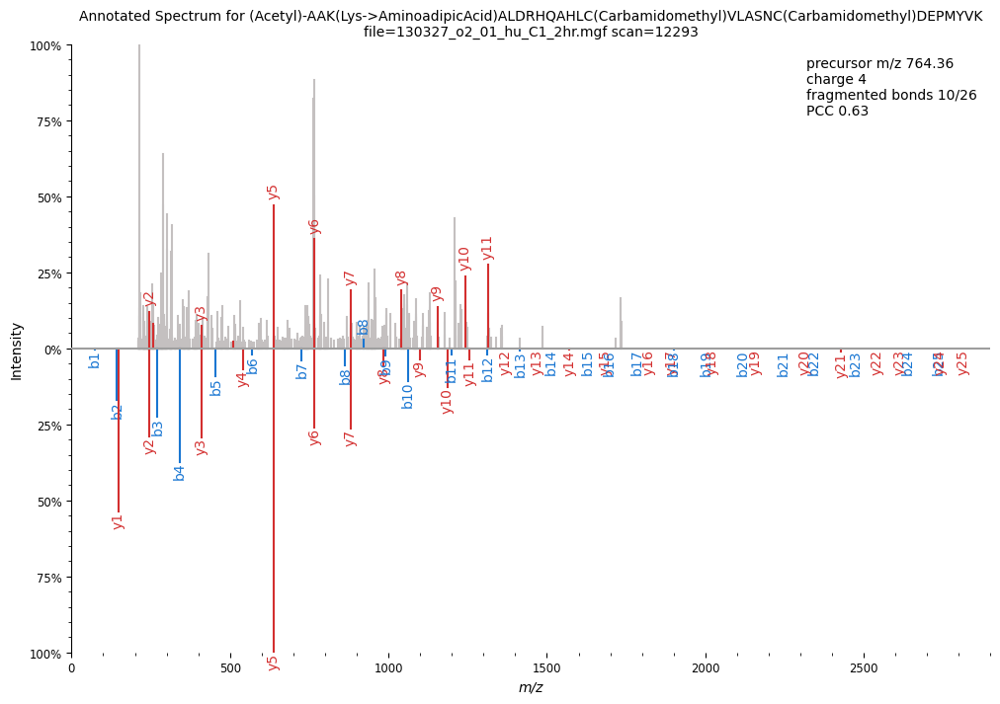

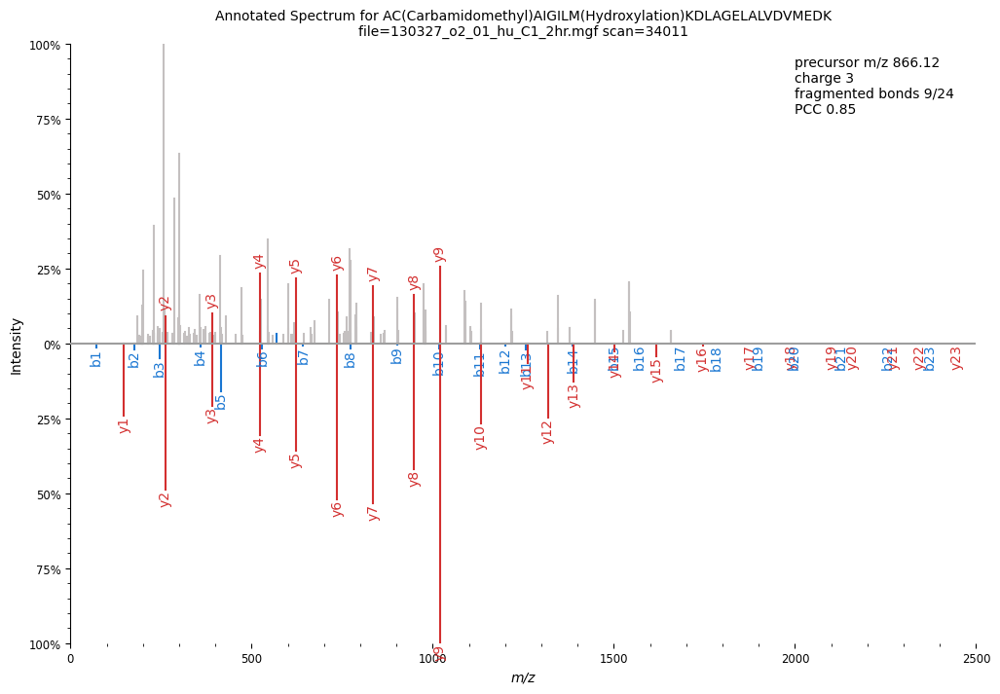

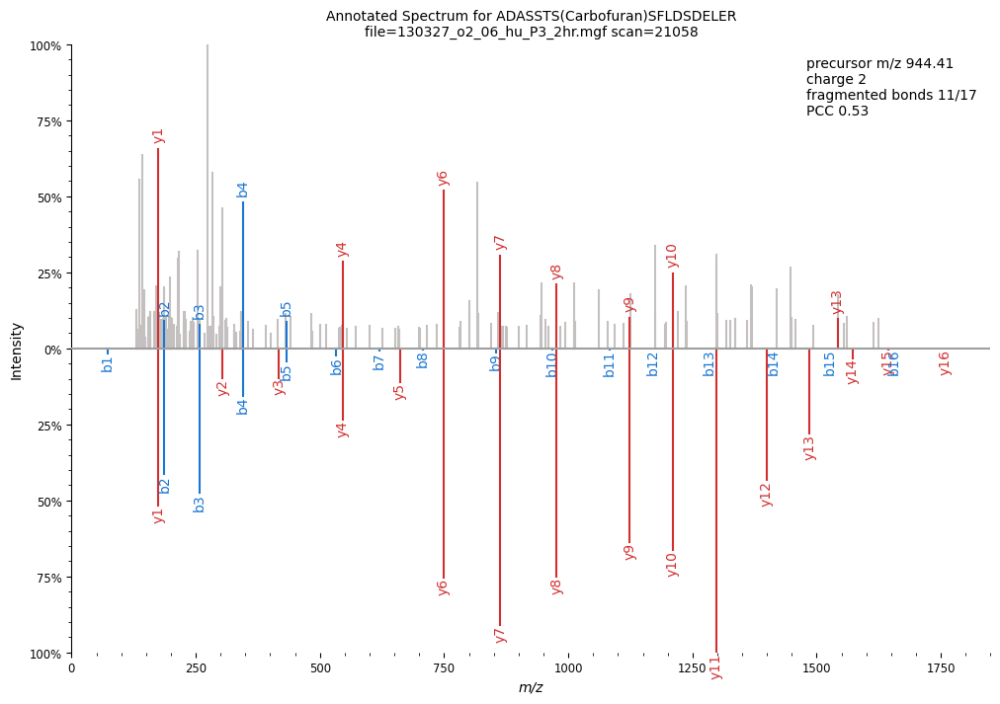

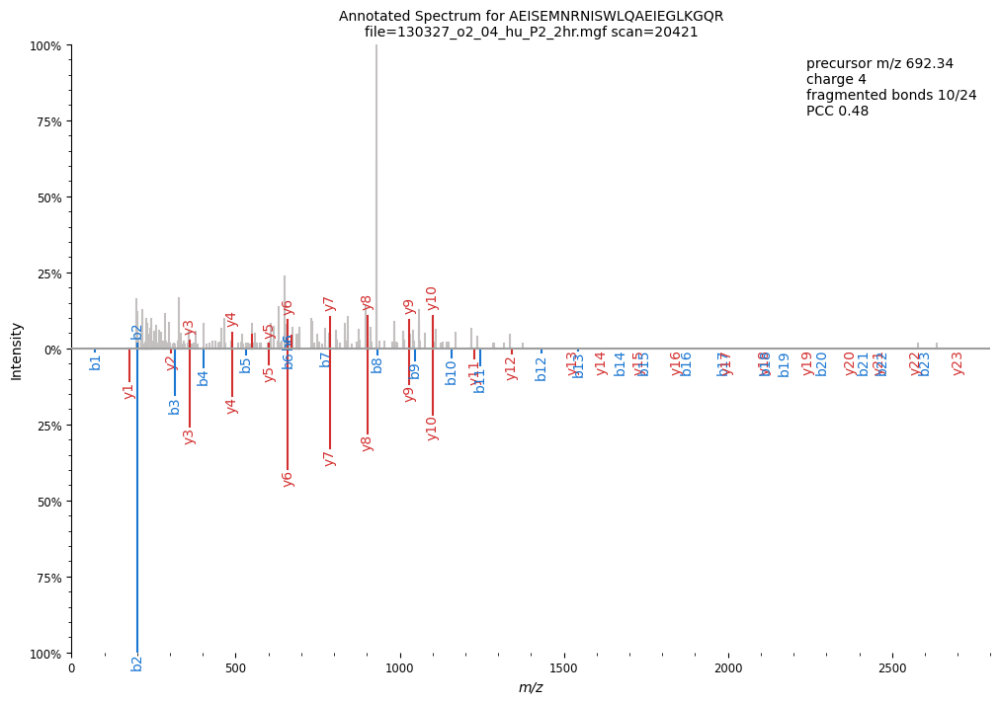

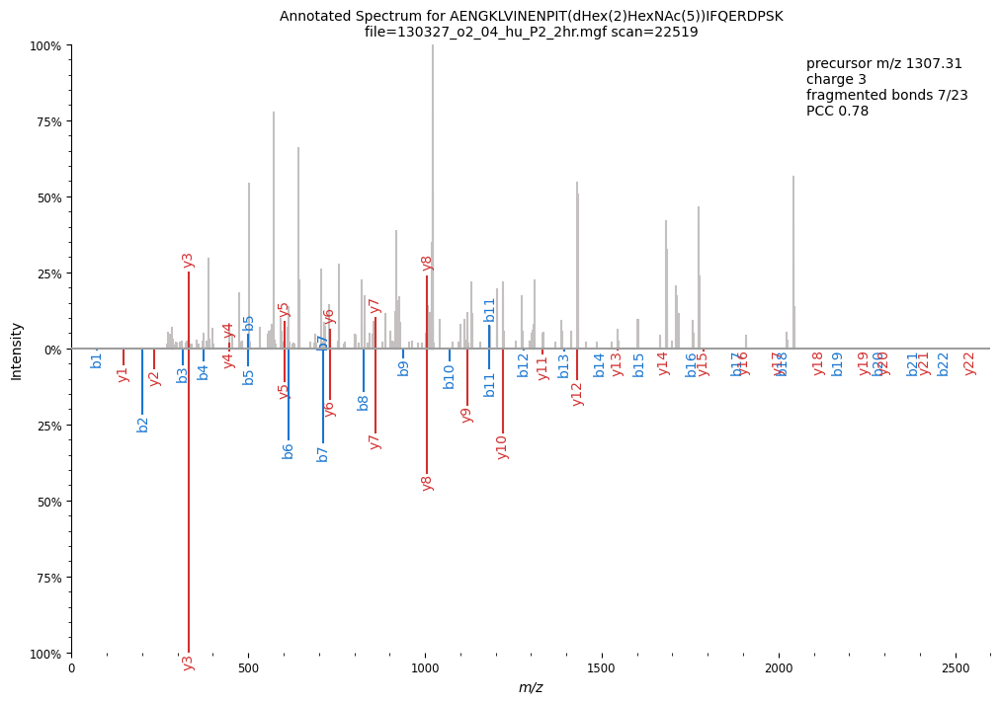

...

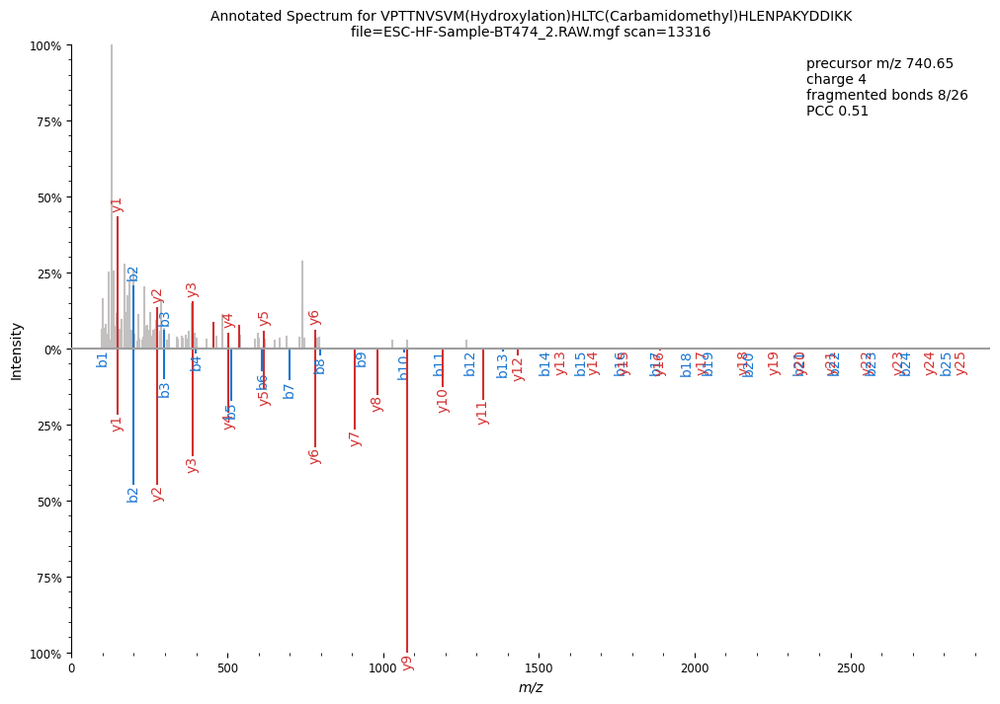

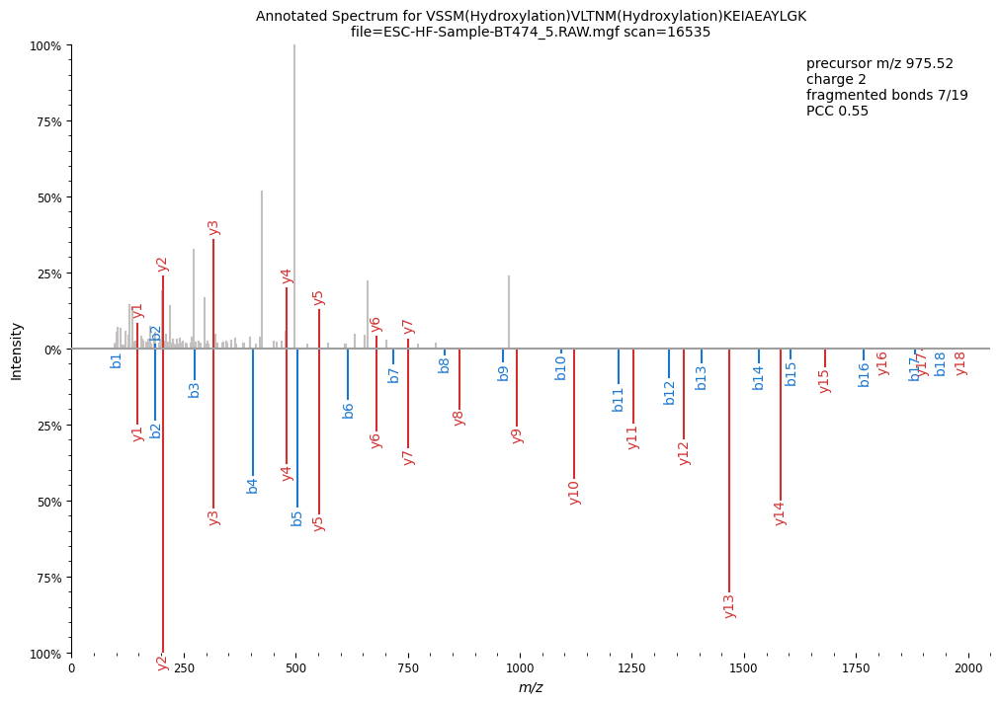

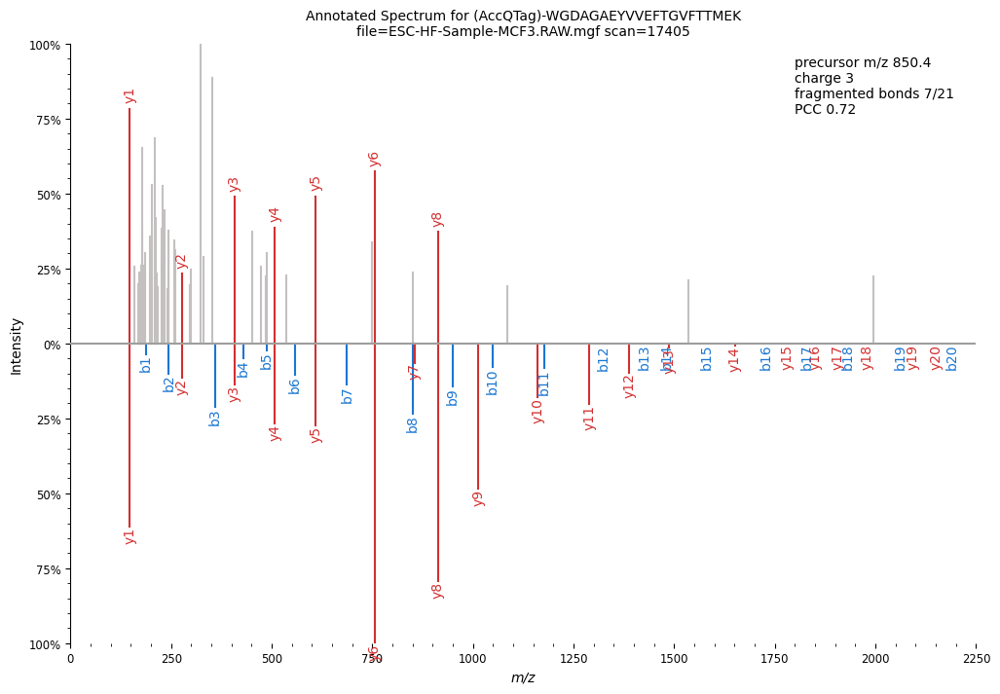

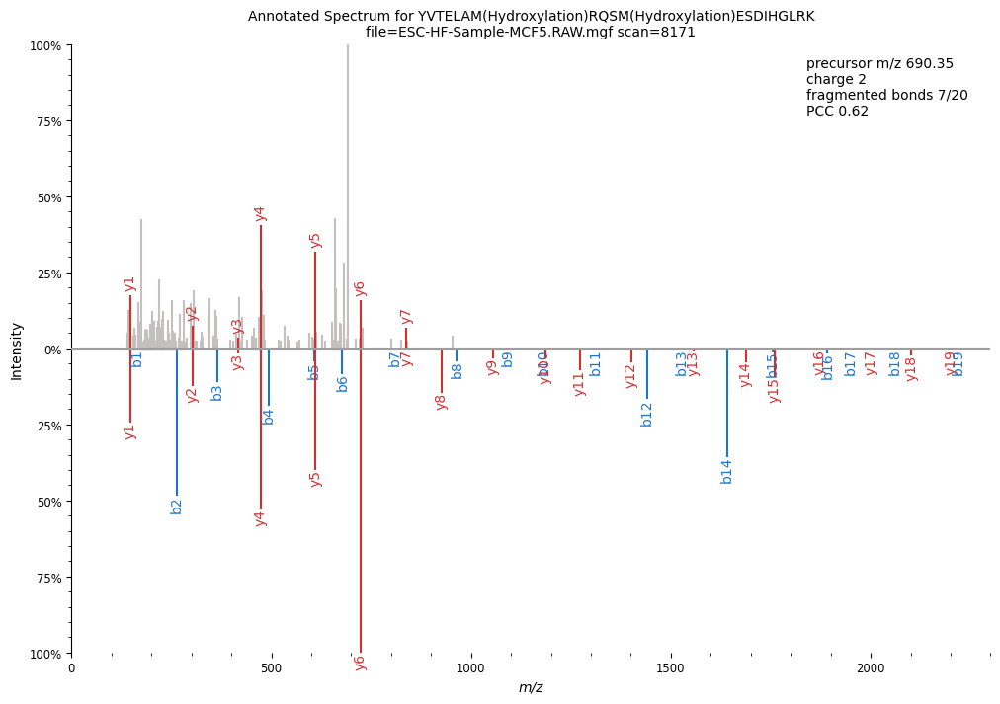

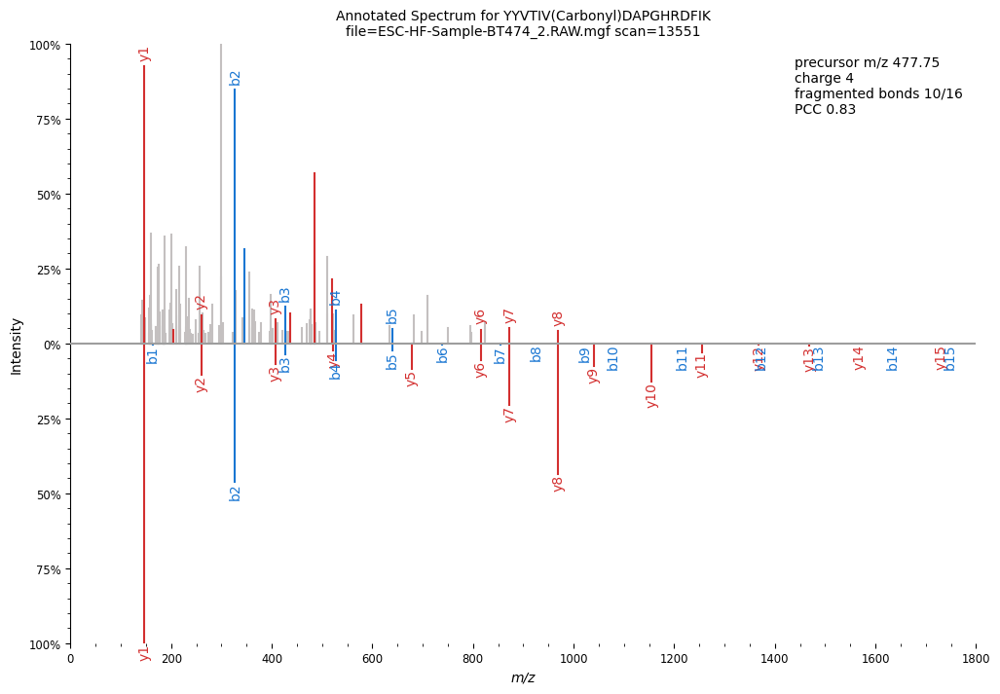

In [408]:
pdf = matplotlib.backends.backend_pdf.PdfPages("nc_HPPpass_best_psms_v4.pdf")
PCC_dict={}
BB_dict={}
for key in nc_spectra_mgf_dict.keys():
    print(key)
    scan=int(nc_spectra_mgf_dict[key]["identifier"].lstrip("scan="))
    ms2pip_spec=ms2pip_spectra[ms2pip_spectra.spec_id==scan]
    plot_mz_min,plot_mz_max=ms2pip_spec.mz.min()-10, ms2pip_spec.mz.max()+10
    # Create the spectrum
    spec = sus.MsmsSpectrum(
        identifier=nc_spectra_mgf_dict[key]["identifier"],
        precursor_mz=nc_spectra_mgf_dict[key]["precursor_mz"],
        precursor_charge=nc_spectra_mgf_dict[key]["precursor_charge"], 
        mz=nc_spectra_mgf_dict[key]["mz"],
        intensity=nc_spectra_mgf_dict[key]["intensity"],
        retention_time=nc_spectra_mgf_dict[key]["retention_time"]
    )

    # Set mz range and filter
    spec = spec.set_mz_range(min_mz=plot_mz_min, max_mz=plot_mz_max)  
    spec = spec.scale_intensity() 
    #spec = spec.filter_intensity(0.01) 


    # Annotate with peptide sequence
    #peptide_sequence = nc_toexplore[nc_toexplore.scan == scan].database_peptide_x.iloc[0]
    peptide_sequence=nc_toexplore.loc[nc_toexplore.scan==scan,"pyteomics_peptide"].iloc[0]
    spec.annotate_proforma(peptide_sequence, 20, "ppm")

    # Create mirrored spectrum
    mirrored_spec = sus.MsmsSpectrum(
        identifier=spec.identifier,
        precursor_mz=spec.precursor_mz,
        precursor_charge=spec.precursor_charge,
        mz=ms2pip_spec.mz.to_numpy(),
        intensity=ms2pip_spec.prediction.to_numpy(),
        retention_time=spec.retention_time
    )

    mirrored_spec = mirrored_spec.set_mz_range(min_mz=plot_mz_min, max_mz=plot_mz_max)  
    mirrored_spec = mirrored_spec.scale_intensity() 
    #mirrored_spec = mirrored_spec.filter_intensity(0.01) 
    
    peptide_sequence_ms2pip=nc_toexplore.loc[nc_toexplore.scan==scan,"database_peptide_x"].iloc[0]
    mirrored_spec.annotate_proforma(peptide_sequence_ms2pip, 20, "ppm")
    
    pcc,spec_merge=PCC(spec,mirrored_spec)
    PCC_dict[key]=pcc
    frb=len(set([int(ion.replace("b","").replace("y","")) for ion in spec_merge[spec_merge["0spec"]!=0].index]))
    pep=nc_toexplore.loc[nc_toexplore.scan==scan,"database_peptide_x"].iloc[0]
    BB_dict[key]=frb/len(pep)
    
    # Plot original and mirrored spectra
    fig, ax = plt.subplots(figsize=(12, 8))

    # Plot mirrored (bottom)

    sup.mirror(spec, mirrored_spec, ax=ax,spectrum_kws={"grid":False})    
    #sup.facet(spec, spec, mirrored_spec, ax=ax,spectrum_kws={"grid":False})    
    
    info=f'precursor m/z {round(nc_spectra_mgf_dict[key]["precursor_mz"],2)}\ncharge {nc_spectra_mgf_dict[key]["precursor_charge"]}\nfragmented bonds {frb}/{len(pep)}\nPCC {round(pcc,2)}\n'
    ax.text(
        0.80, 0.98,
        info, 
        ha='left', va='top',
        transform=ax.transAxes,
        fontsize=10, color='black',
        bbox=dict(facecolor='white', alpha=0.5, edgecolor='none'))
    
    # Titles and labels
    peptide_sequence_plot=nc_toexplore.loc[nc_toexplore.scan==scan,"custom_peptide"].iloc[0]
    ax.set_title(f"Annotated Spectrum for {peptide_sequence_plot}\nfile={nc_spectra_mgf_dict[key]['mgf']} scan={scan}",fontsize=10)
    ax.set_xlabel("m/z")
    ax.set_ylabel("Intensity")
    ax.spines['bottom'].set_visible(False)       
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    
    #plt.show()
    pdf.savefig(fig)
pdf.close()

In [312]:
pdf.close()

In [296]:
from inspect import getmembers, isfunction
#no facet or mass_errors :(
print(getmembers(sup, isfunction))

[('_annotate_ion', <function _annotate_ion at 0x000001EFB6FE9080>), ('annotate_ion_type', <function annotate_ion_type at 0x000001EFBBA1A0C0>), ('mirror', <function mirror at 0x000001EFBD4DC540>), ('spectrum', <function spectrum at 0x000001EFBD4DC4A0>)]


130327_o2_02_hu_P1_2hr.28850.28850.2 File:"130327_o2_02_hu_P1_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=28850"
controllerType=0 controllerNumber=1 scan=10336


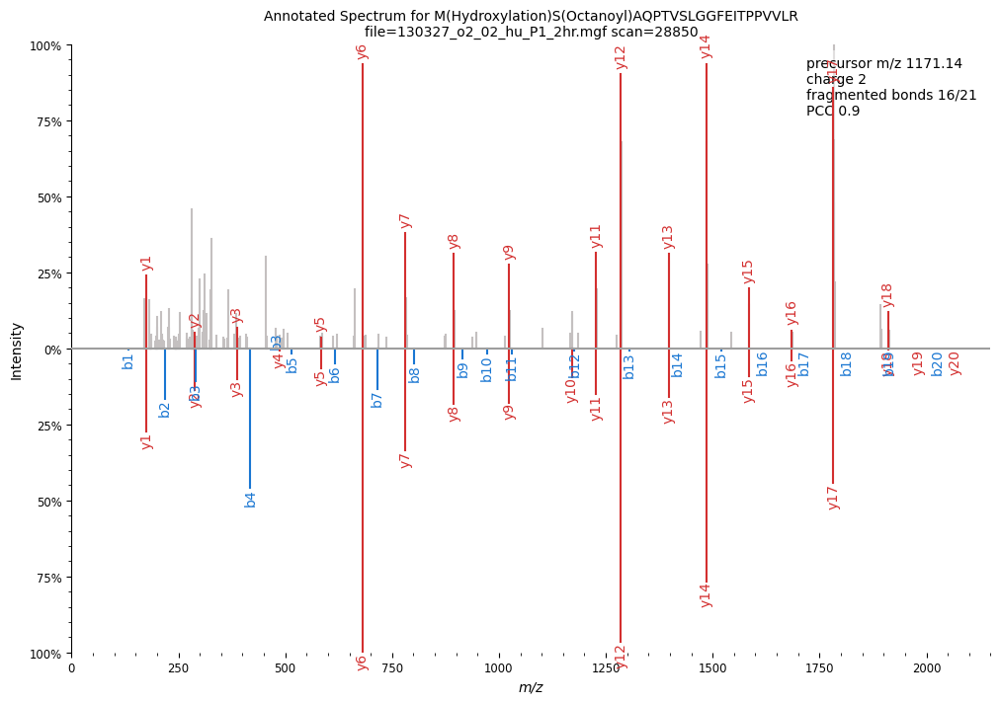

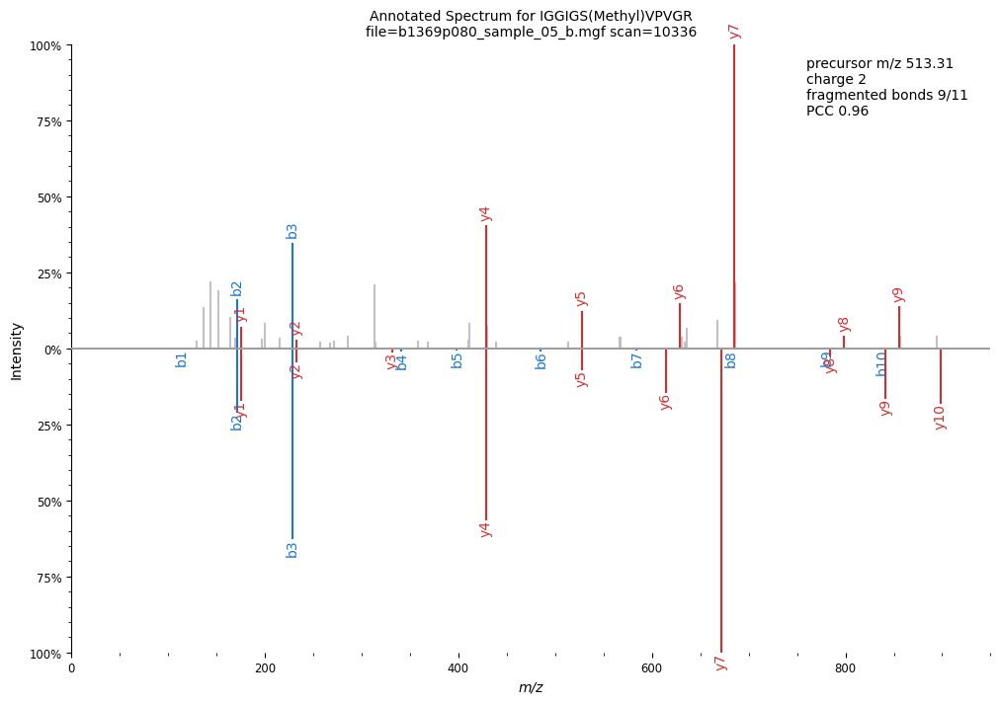

In [404]:
#save scan 16188 as svg
for key in nc_spectra_mgf_dict.keys():   
    scan=int(nc_spectra_mgf_dict[key]["identifier"].lstrip("scan="))
    if scan not in [28850,10336]: continue
    print(key)
    ms2pip_spec=ms2pip_spectra[ms2pip_spectra.spec_id==scan]
    plot_mz_min,plot_mz_max=ms2pip_spec.mz.min()-10, ms2pip_spec.mz.max()+10
    # Create the spectrum
    spec = sus.MsmsSpectrum(
        identifier=nc_spectra_mgf_dict[key]["identifier"],
        precursor_mz=nc_spectra_mgf_dict[key]["precursor_mz"],
        precursor_charge=nc_spectra_mgf_dict[key]["precursor_charge"], 
        mz=nc_spectra_mgf_dict[key]["mz"],
        intensity=nc_spectra_mgf_dict[key]["intensity"],
        retention_time=nc_spectra_mgf_dict[key]["retention_time"]
    )

    spec = spec.set_mz_range(min_mz=plot_mz_min, max_mz=plot_mz_max)  
    spec = spec.scale_intensity() 

    peptide_sequence=nc_toexplore.loc[nc_toexplore.scan==scan,"pyteomics_peptide"].iloc[0]
    spec.annotate_proforma(peptide_sequence, 20, "ppm")

    mirrored_spec = sus.MsmsSpectrum(
        identifier=spec.identifier,
        precursor_mz=spec.precursor_mz,
        precursor_charge=spec.precursor_charge,
        mz=ms2pip_spec.mz.to_numpy(),
        intensity=ms2pip_spec.prediction.to_numpy(),
        retention_time=spec.retention_time
    )

    mirrored_spec = mirrored_spec.set_mz_range(min_mz=plot_mz_min, max_mz=plot_mz_max)  
    mirrored_spec = mirrored_spec.scale_intensity() 

    peptide_sequence_ms2pip=nc_toexplore.loc[nc_toexplore.scan==scan,"database_peptide_x"].iloc[0]
    mirrored_spec.annotate_proforma(peptide_sequence_ms2pip, 20, "ppm")
    
    pcc,spec_merge=PCC(spec,mirrored_spec)
    frb=len(set([int(ion.replace("b","").replace("y","")) for ion in spec_merge[spec_merge["0spec"]!=0].index]))
    pep=nc_toexplore.loc[nc_toexplore.scan==scan,"database_peptide_x"].iloc[0]
    
    fig, ax = plt.subplots(figsize=(12, 8))


    sup.mirror(spec, mirrored_spec, ax=ax,spectrum_kws={"grid":False})      
   
    info=f'precursor m/z {round(nc_spectra_mgf_dict[key]["precursor_mz"],2)}\ncharge {nc_spectra_mgf_dict[key]["precursor_charge"]}\nfragmented bonds {frb}/{len(pep)}\nPCC {round(pcc,2)}\n'
    ax.text(
        0.80, 0.98,
        info, 
        ha='left', va='top',
        transform=ax.transAxes,
        fontsize=10, color='black',
        bbox=dict(facecolor='white', alpha=0.5, edgecolor='none'))
    
    # Titles and labels
    peptide_sequence_plot=nc_toexplore.loc[nc_toexplore.scan==scan,"custom_peptide"].iloc[0]
    ax.set_title(f"Annotated Spectrum for {peptide_sequence_plot}\nfile={nc_spectra_mgf_dict[key]['mgf']} scan={scan}",fontsize=10)
    ax.set_xlabel("m/z")
    ax.set_ylabel("Intensity")
    ax.spines['bottom'].set_visible(False)       
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    plt.savefig(f"{nc_spectra_mgf_dict[key]['mgf']}_{scan}_spec.svg")

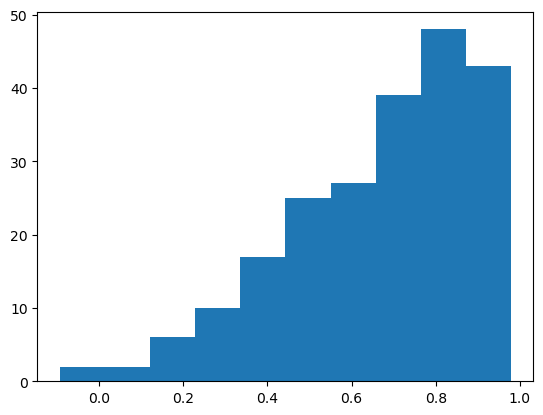

In [406]:
#visualise PCC
plt.hist(list(PCC_dict.values()));

In [410]:
a=np.array(list(PCC_dict.values()))
len(a[a>=0.7])/len(a)

0.5296803652968036

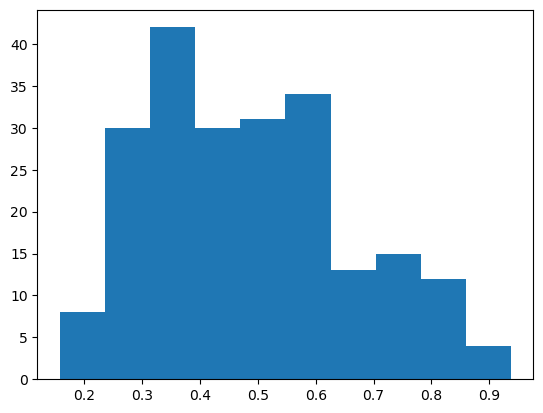

In [409]:
plt.hist(list(BB_dict.values()));

In [412]:
a=np.array(list(BB_dict.values()))
(len(a[a>=0.9])/len(a))*100

1.36986301369863

In [ ]:
#---------------not needed------------------

In [122]:
#WARNING: The script psm_utils.exe is installed in 'C:\Users\vasv1101\AppData\Roaming\Python\Python311\Scripts' which is not on PATH.
pip install ms2pip --user

  Obtaining dependency information for ms2pip from https://files.pythonhosted.org/packages/55/13/1c0bcc875c82bfb68ff63c676445f10f703d9e55cd93ceca3f2f7c91bd2a/ms2pip-4.1.0-cp311-cp311-win_amd64.whl.metadata
  Using cached ms2pip-4.1.0-cp311-cp311-win_amd64.whl.metadata (22 kB)
  Obtaining dependency information for xgboost<3,>=1.3 from https://files.pythonhosted.org/packages/43/80/0b5a2dfcf5b4da27b0b68d2833f05d77e1a374d43db951fca200a1f12a52/xgboost-2.1.4-py3-none-win_amd64.whl.metadata
  Using cached xgboost-2.1.4-py3-none-win_amd64.whl.metadata (2.1 kB)
  Obtaining dependency information for rich>=13 from https://files.pythonhosted.org/packages/19/71/39c7c0d87f8d4e6c020a393182060eaefeeae6c01dab6a84ec346f2567df/rich-13.9.4-py3-none-any.whl.metadata
  Using cached rich-13.9.4-py3-none-any.whl.metadata (18 kB)
  Obtaining dependency information for pydantic>=2 from https://files.pythonhosted.org/packages/f4/3c/8cc1cc84deffa6e25d2d0c688ebb80635dfdbf1dbea3e30c541c8cf4d860/pydantic-2.10.6-py

  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
d3graph 2.5.0 requires markupsafe==2.0.1, but you have markupsafe 3.0.2 which is incompatible.
anaconda-cloud-auth 0.1.3 requires pydantic<2.0, but you have pydantic 2.10.6 which is incompatible.


In [124]:
!pip uninstall markupsafe && pip install markupsafe==2.0.1
!pip uninstall pydantic && pip install pydantic<2.0

^C
^C


In [125]:
pip uninstall markupsafe

^C
Note: you may need to restart the kernel to use updated packages.


In [ ]:
####

In [62]:
a=[v["identifier"] for k,v in nc_spectra_dict.items() if v["identifier"].startswith("scan")]
a1=[v["precursor_charge"] for k,v in nc_spectra_dict.items() if v["identifier"].startswith("scan")]
a2=[v["mgf"] for k,v in nc_spectra_dict.items() if v["identifier"].startswith("scan")]
a3=[v["charge from ionbot"] for k,v in nc_spectra_dict.items() if v["identifier"].startswith("scan")]

b=[k for k,v in nc_spectra_dict.items() if v["identifier"].startswith("scan")]

c=pd.DataFrame({"scan":a,"title":b,"mgf":a2,"charge":a1,"ionbot_charge":a3})
c[c.charge!=c.ionbot_charge]

,scan,title,mgf,charge,ionbot_charge


In [63]:
#table for scores
#some charge can be different from in ionbot annotation if mgf did not contain the same
#but here we have same charge as in ionbot
nc_toexplore_forscore=pd.DataFrame(columns=["dataset","spectrum_file","scan","sequence","charge"])
for i,row in nc_toexplore.iterrows():
    target_file=row["spectrum_file_x"]
    peptide_sequence=row["unimod_peptide"]
    set_charge=row["charge"]
    dataset=row["dataset"]
    nc_toexplore_forscore.loc[len(nc_toexplore_forscore)]=[dataset, target_file, row['scan'],peptide_sequence,set_charge]
nc_toexplore_forscore[["Marie score","Marie comment","Valeriia score","Valeriia comment"]]=np.nan

In [64]:
nc_toexplore_forscore.to_excel("nc_toexplore_forscore.xlsx",index=False)

In [36]:
nc_toexplore_forscore=pd.read_excel("nc_toexplore_forscore.xlsx")

In [65]:
#what about weird repeating modifications?
#they accure because ionbot contains sometimes several same peptidoforms of different (expected?) retention time
#try to delet them and see if it changes spectra visualisation
weird_modpep_scan=[28837,25461,23567,31024,19920,16159,22040,13350,8789,7753]
nc_toexplore_weird_modpep=nc_toexplore[nc_toexplore.scan.isin(weird_modpep_scan)]
nc_toexplore_weird_modpep.unimod_peptide=['DGS[UNIMOD:23]ASGT[UNIMOD:23]M[UNIMOD:35]LLEALDC[UNIMOD:4]ILPPTHPTDKPLR',
       '[UNIMOD:1]-M[UNIMOD:35]AIAT[UNIMOD:1765]GGAVFGEEGLT[UNIMOD:1654]LNLEDVQPHDLGK',
       'M[UNIMOD:35]C[UNIMOD:4]DIKEKLC[UNIMOD:4]YVALEFEQEM[UNIMOD:35]ASAASSSSLEK',
       '[UNIMOD:1]-MDMDMS[UNIMOD:40]PLR[UNIMOD:21]PQNYLFGC[UNIMOD:4]ELK',
       'FRC[UNIMOD:4]PEALFQ[UNIMOD:35]PSF[UNIMOD:35]LGMESC[UNIMOD:4]G[UNIMOD:35]I[UNIMOD:35]H[UNIMOD:35]D[UNIMOD:35]T[UNIMOD:35]T[UNIMOD:35]F[UNIMOD:35]NSIMK',
       'KLK[UNIMOD:1875]L[UNIMOD:34]E[UNIMOD:34]AE[UNIMOD:34]L[UNIMOD:34]GNM[UNIMOD:35]Q[UNIMOD:34]GLVEDFK',
       'LQLETEI[UNIMOD:34]E[UNIMOD:1918]A[UNIMOD:1918]VKEELLFM[UNIMOD:35]K',
       'LVEALC[UNIMOD:4]AE[UNIMOD:1827]HQIDLIKVDDNKK',
       'M[UNIMOD:35]NHEKYDNSLKIVSNASC[UNIMOD:4]TTNC[UNIMOD:4]LAPLAK',
       'TEEL[UNIMOD:1918]N[UNIMOD:34]R[UNIMOD:1918]E[UNIMOD:34]V[UNIMOD:1918]A[UNIMOD:1918]GHTDQLQM[UNIMOD:35]SR']
#checked - no difference

In [85]:
nc_toexplore.loc[nc_toexplore.scan.isin([4015,13243]),["unimod_peptide","charge"]]

,unimod_peptide,charge
83,KLLD[UNIMOD:1385]GEESRLESGMQNMSIHTK,3
103,TTHFVEGGD[UNIMOD:1915]ASNREDQINR,3


In [82]:
#look at spectra where some picks have no labels
[sd["mz"] for k,sd in nc_spectra_mgf_dict.items() if sd["identifier"] in ["scan=4015","scan=13243"]]

[array([ 120.0804138,  129.1021271,  136.0616302,  136.0752411,
         147.1119995,  152.0566711,  154.5608673,  175.118576 ,
         187.1081848,  197.1647034,  199.1803284,  201.1220245,
         201.5642242,  213.0864258,  217.0387878,  223.1547394,
         224.175293 ,  225.1594391,  227.0655518,  232.6582794,
         239.1136322,  243.1323853,  248.15979  ,  249.1588593,
         251.1500092,  252.1544647,  262.1509399,  276.168457 ,
         284.1238403,  301.1294556,  309.2634277,  312.0471497,
         337.2575073,  347.6404114,  355.2686462,  367.2084961,
         381.0930786,  385.2182312,  404.2252808,  404.7171631,
         414.2131653,  415.2165222,  442.2084961,  499.3005066,
         517.7514038,  526.7539063,  527.2991333,  528.295105 ,
         533.2711792,  585.3307495,  597.2155762,  602.3702393,
         604.328125 ,  636.9536133,  661.3621216,  662.3434448,
         715.3117065,  741.3255615,  751.6721191,  780.8900146,
         791.3585815,  797.3833618,  801

scan=28837 130327_o2_05_hu_C3_2hr DGS[UNIMOD:23]ASGT[UNIMOD:23]M[UNIMOD:35]LLEALDC[UNIMOD:4]ILPPTHPTDKPLR 3 PXD002057 11
130327_o2_05_hu_C3_2hr.28837.28837.3 File:"130327_o2_05_hu_C3_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=28837"


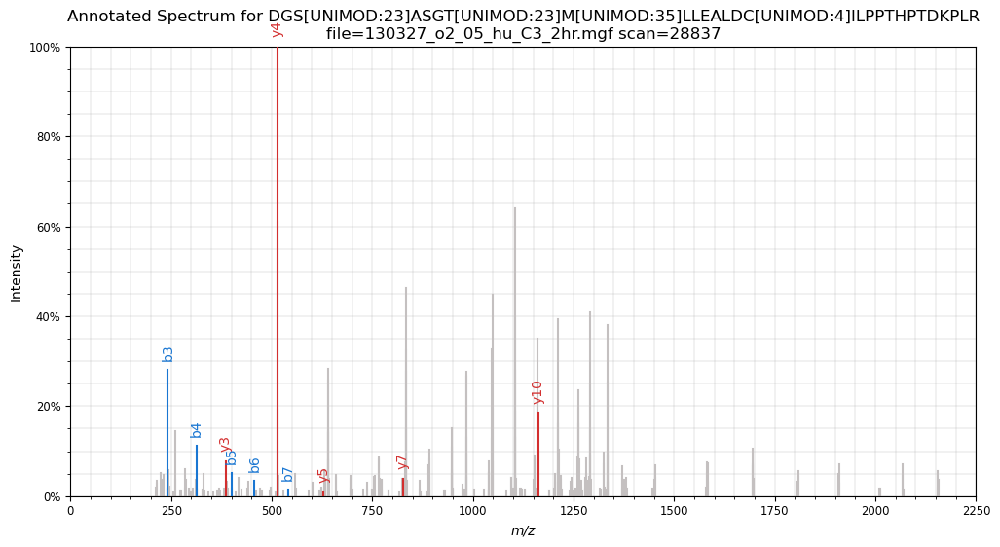

scan=25461 130327_o2_06_hu_P3_2hr [UNIMOD:1]-M[UNIMOD:35]AIAT[UNIMOD:1765]GGAVFGEEGLT[UNIMOD:1654]LNLEDVQPHDLGK 4 PXD002057 41
130327_o2_06_hu_P3_2hr.25461.25461.4 File:"130327_o2_06_hu_P3_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=25461"


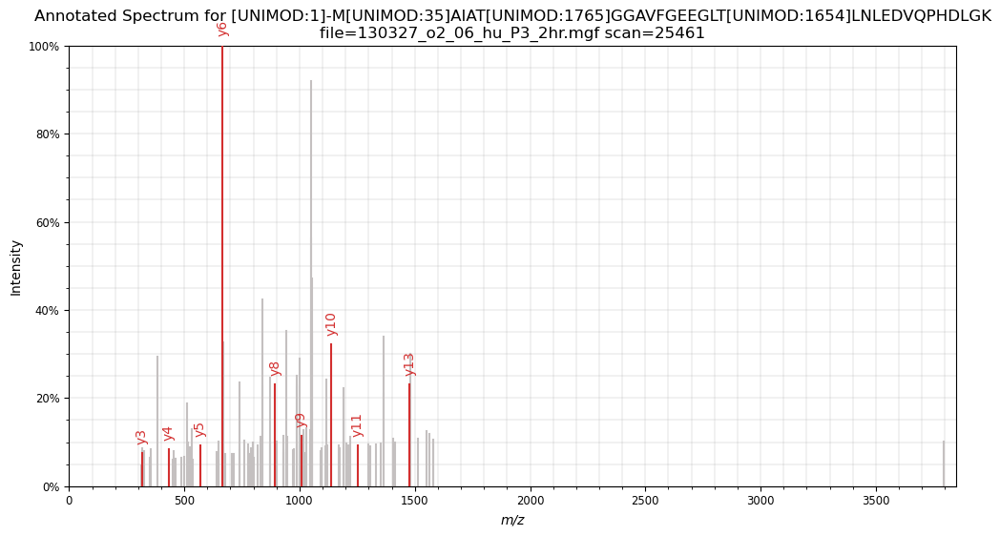

scan=23567 130327_o2_01_hu_C1_2hr M[UNIMOD:35]C[UNIMOD:4]DIKEKLC[UNIMOD:4]YVALEFEQEM[UNIMOD:35]ASAASSSSLEK 3 PXD002057 43
130327_o2_01_hu_C1_2hr.23567.23567.3 File:"130327_o2_01_hu_C1_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=23567"


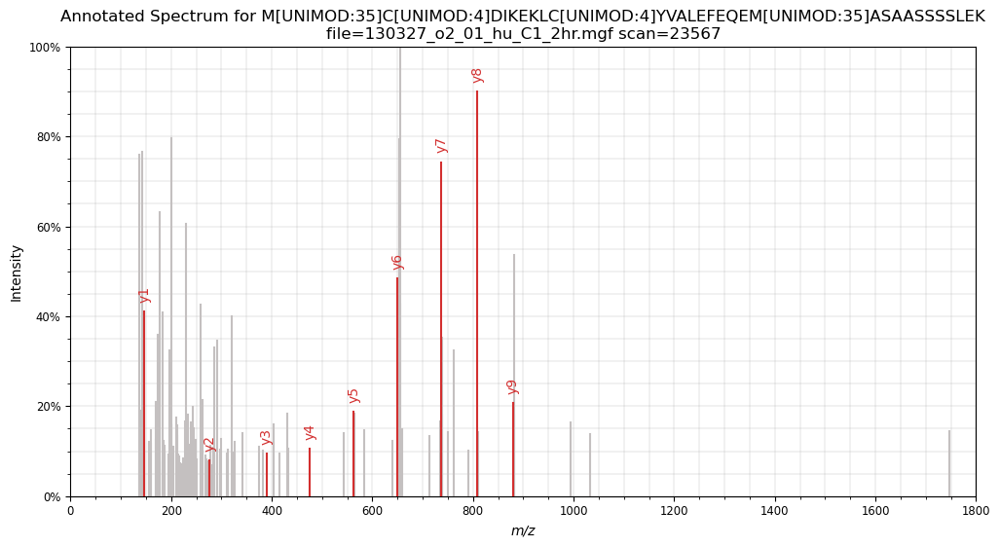

scan=31024 b1369p080_sample_05_a [UNIMOD:1]-MDMDMS[UNIMOD:40]PLR[UNIMOD:21]PQNYLFGC[UNIMOD:4]ELK 3 PXD003594 90
controllerType=0 controllerNumber=1 scan=31024


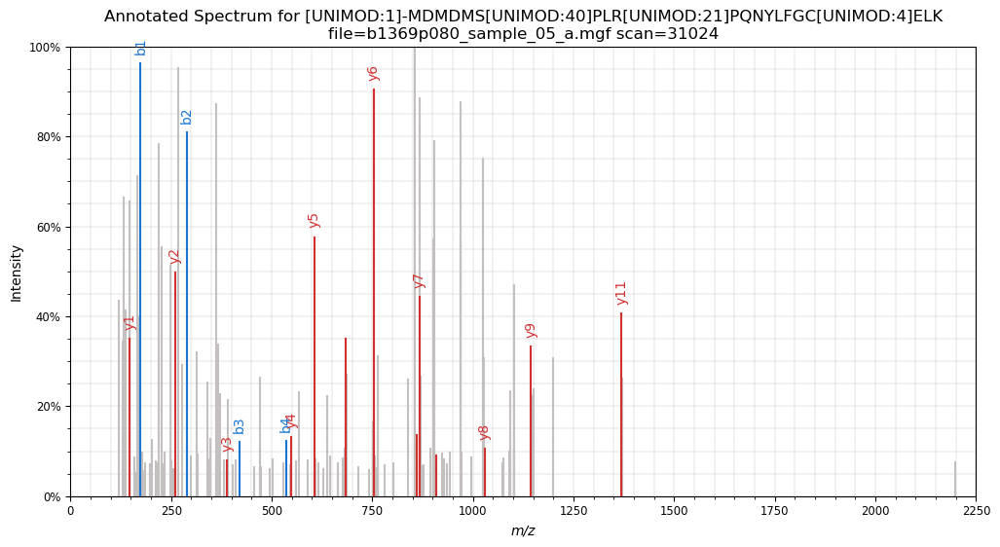

scan=19920 ESC-HF-Sample-MCF5 FRC[UNIMOD:4]PEALFQ[UNIMOD:35]PSF[UNIMOD:35]LGMESC[UNIMOD:4]G[UNIMOD:35]I[UNIMOD:35]H[UNIMOD:35]D[UNIMOD:35]T[UNIMOD:35]T[UNIMOD:35]F[UNIMOD:35]NSIMK 4 PXD014258 129
controllerType=0 controllerNumber=1 scan=19920


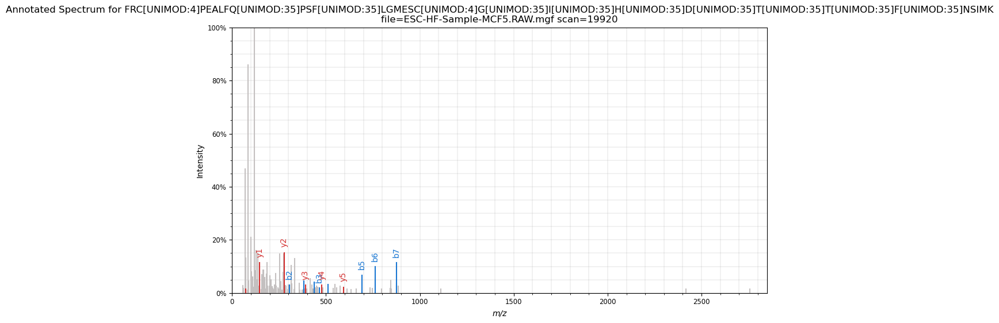

scan=16159 ESC-HF-Sample-MCF2 KLK[UNIMOD:1875]L[UNIMOD:34]E[UNIMOD:34]AE[UNIMOD:34]L[UNIMOD:34]GNM[UNIMOD:35]Q[UNIMOD:34]GLVEDFK 3 PXD014258 148
controllerType=0 controllerNumber=1 scan=16159


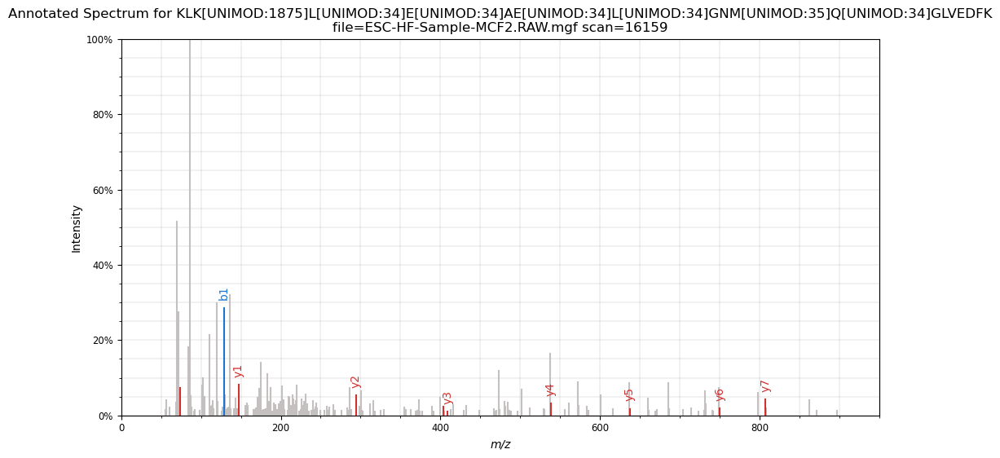

scan=22040 ESC-HF-Sample-MCF5 LQLETEI[UNIMOD:34]E[UNIMOD:1918]A[UNIMOD:1918]VKEELLFM[UNIMOD:35]K 3 PXD014258 166
controllerType=0 controllerNumber=1 scan=22040


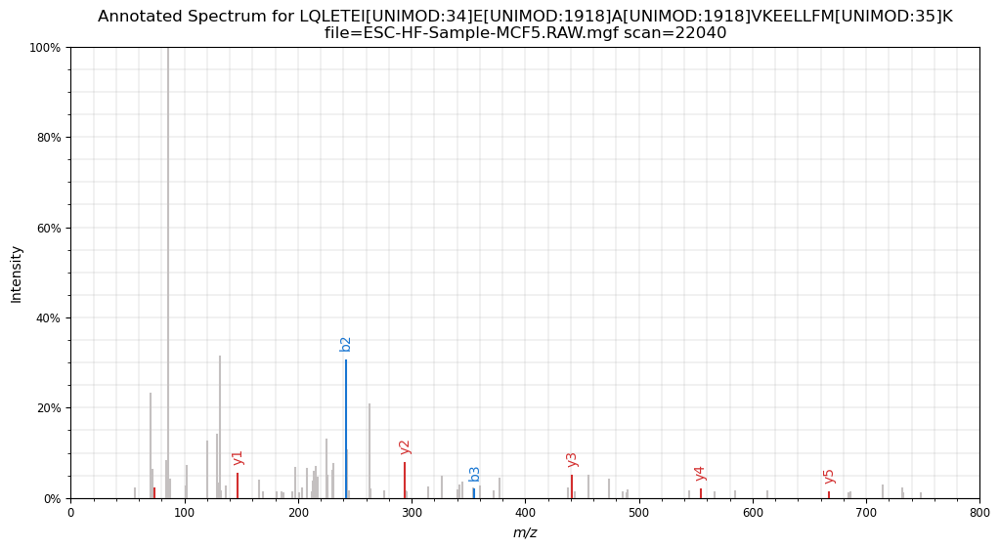

scan=13350 ESC-HF-Sample-MCF4 LVEALC[UNIMOD:4]AE[UNIMOD:1827]HQIDLIKVDDNKK 4 PXD014258 170
controllerType=0 controllerNumber=1 scan=13350


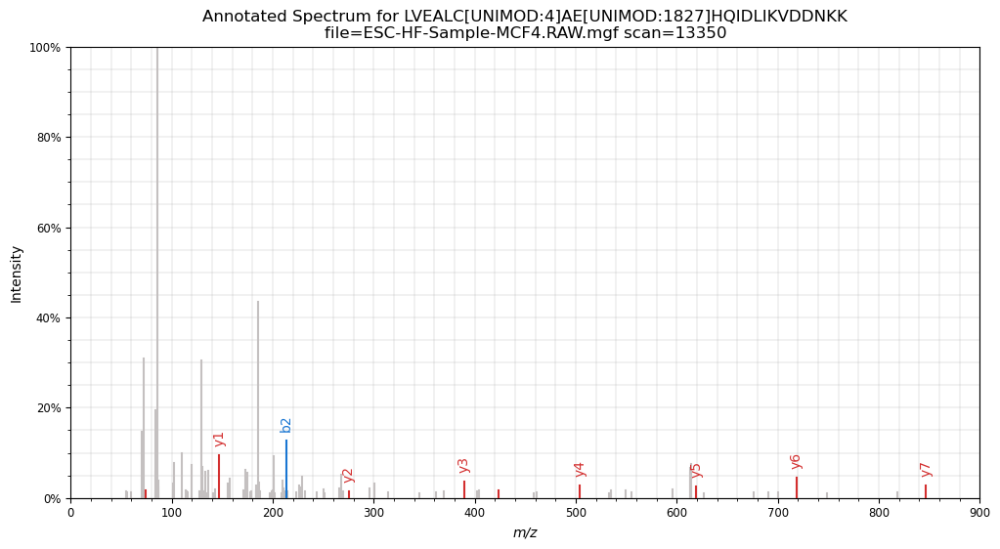

KeyboardInterrupt: 

In [75]:
for i,row in nc_toexplore_weird_modpep.iterrows():
    target_title=f"scan={row['scan']}"
    target_file=row["spectrum_file_x"].split(".")[0]
    peptide_sequence=row["unimod_peptide"]
    set_charge=row["charge"]
    dataset=row["dataset"]
    mgf_file =row["spectrum_file_x"] 
    spectra = mgf.read(os.path.join(mgf_folder,dataset,mgf_file)) #read each time againe
    print(target_title, target_file, peptide_sequence,set_charge,dataset, i)
    # Parse the MGF file and find the matching spectrum
    for spectrum in spectra:
        if target_title in spectrum['params']['title']: 
            print(spectrum['params']['title'])
            mz_values = np.array(spectrum['m/z array'])
            intensities = np.array(spectrum['intensity array'])
            precursor_mz = float(spectrum['params'].get('pepmass', [0])[0])

            # Ensure charge is an integer
            charge = spectrum['params'].get('charge', [set_charge])
            if isinstance(charge, list):  # Some MGF files store charge as a list
                try:
                    charge = charge[charge.index(set_charge)]
                except ValueError:
                    charge = charge[0] #if no ionbot charge in list, then take first
            precursor_charge = int(charge)  # Convert to int explicitly

            retention_time = float(spectrum['params'].get('rtinseconds', float('nan')))
            
            nc_spectra_dict[spectrum['params']['title']]={
                "mgf":mgf_file,
                "identifier":target_title,
                "precursor_mz":precursor_mz,
                "precursor_charge":precursor_charge,  # Ensure it's an int
                "charge from ionbot":set_charge,
                "mz":mz_values,
                "intensity":intensities,
                "retention_time":retention_time
            }
            
            # Create an MsmsSpectrum object with the updated constructor
            spec = sus.MsmsSpectrum(
                identifier=target_title,
                precursor_mz=precursor_mz,
                precursor_charge=precursor_charge,  # Ensure it's an int
                mz=mz_values,
                intensity=intensities,
                retention_time=retention_time
            )

            # Preprocess the spectrum
            spec = spec.set_mz_range(min_mz=np.min(mz_values)-10, max_mz=np.max(mz_values)+10)  # Limit m/z range #how ?
            spec = spec.scale_intensity()  # Normalize intensity
            spec = spec.filter_intensity(0.01)  # Filter low-intensity peaks

            # Annotate the spectrum with the given peptide sequence
            spec.annotate_proforma(peptide_sequence, 20, "ppm")

            # Plot the annotated spectrum
            fig, ax = plt.subplots(figsize=(12, 6))
            sup.spectrum(spec, ax=ax)
            plt.title(f"Annotated Spectrum for {peptide_sequence}\nfile={mgf_file} {target_title}")
            plt.show()
            break  # Stop searching after finding the correct spectrum

            break  # Stop searching after finding the correct spectrum
    else:
        print("Spectrum not found.", target_title, target_file, dataset, charge, i)